In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import pickle
import holidays
from scipy import stats
import xgboost as xgb
import optuna
from prophet import Prophet
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
import matplotlib.pyplot as plt
from sklearn.model_selection import learning_curve

In [2]:
pd.set_option('display.max_columns', None)

def load_model(model_path):
    model_final = None

    if os.path.exists(model_path):
        print('Model is already')

        with open(model_path, 'rb') as f:
            model_final = pickle.load(f)

    return model_final

def save_model(model, model_path):
    with open(model_path, "wb") as f:
        pickle.dump(model, f)

def calculate_mape(ytrue, yhat):
    " Calculate MAPE"
    return np.round(((np.abs(ytrue - yhat) / ytrue) * 100), 2)

def calculate_RMSE(ytrue, yhat):
    " Calculate RMSE"
    return np.round(np.sqrt(np.mean((ytrue - yhat)**2)), 2)

def calculate_MAE(ytrue, yhat):
    " Calculate MAE"
    return np.round(np.mean(np.abs(ytrue - yhat)), 2)

def calculate_MASE(ytrue, yhat, y_naive):
    " Calculate MASE"
    return np.round(np.mean(np.abs(ytrue - yhat)) / np.mean(np.abs(ytrue - y_naive)), 2)

In [3]:
def datetime_feature_engineering(df_copy):
    
    df = df_copy.copy()
    """
    This function takes a DataFrame and adds new features related to the 'datetime' object of the time series.
    features added : 'season', 'day_of_week', 'is_weekday'
    
    Parameters:
    df (DataFrame): The input DataFrame with a 'datetime' column.
    
    Returns:
    DataFrame: The DataFrame with the new features added.
    """
    # Convert 'datetime' column to datetime object
    df['datetime'] = pd.to_datetime(df['datetime'])
    
    # Create 'hour' feature
    df['hour'] = df['datetime'].dt.hour
    
    # Create 'month' feature
    df['month'] = df['datetime'].dt.month_name()
    
    # Create 'year' feature
    df['year'] = df['datetime'].dt.year
        
    # Create 'season' feature
    df['season'] = df['datetime'].dt.month%12 // 3 + 1
    seasons = {1: 'Winter', 2: 'Spring', 3: 'Summer', 4: 'Autumn'}
    df['season'] = df['season'].map(seasons)
    
    # Create 'day_of_week' feature
    df['day_of_week'] = df['datetime'].dt.day_name()
    
    # Define the correct order
    day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

    # Convert 'day_of_week' to ordered categorical type
    df['day_of_week'] = pd.Categorical(df['day_of_week'], categories=day_order, ordered=True)
    
    # Create 'is_weekday' feature
    df['is_weekday'] = df['day_of_week'].apply(lambda x: True if x in ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday'] else False)
    
    return df

    
    
# Hour periods 
def hour_periods(x):
    if x in range(0, 3):
        return 'Period 0-2'
    elif x in range(3, 5):
        return 'Period 2-4'
    elif x in range(5, 12):
        return 'Period 4-11'
    elif x in range(12, 18):
        return 'Period 12-17'
    elif x in range(18, 21):
        return 'Period 18-20'
    else:
        return 'Period 21-23'

def create_lagged_features(df, target_col):
    # Create lagged features for 24, 48, 72 hours and 1, 2 weeks
    for lag in [24, 48, 72, 24*7, 2*24*7]:
        df[f'{target_col}_lag_{lag}'] = df[target_col].shift(lag)
        
        # As we created the lagged features using the entire dataset, we have to fill the missing values with the train set values
        # As these nan values are at the begining of the dataset and small in number, we can use backward fill 
        
        # Backward fill
        df[f'{target_col}_lag_{lag}'] = df[f'{target_col}_lag_{lag}'].fillna(method='bfill')
        
        
    return df


def remove_lagged_features(df, target_col,lag_list):
    for lag in lag_list:
        df.drop(f'{target_col}_lag_{lag}',axis=1,inplace=True)
        
    return df


def wind_gust_impact(data_copy):
    """
    This function calculates the impact of wind gusts on power production.
    
    Parameters:
    data (DataFrame): The input DataFrame with 'windgusts10m', 'windspeed100m' and 'windspeed10m' columns.
    
    Returns:
    DataFrame: The DataFrame with the new 'wind_gust_impact' feature.
    """
    data = data_copy.copy()
    average_wind_speed = (data['windSpeed100m'] + data['windSpeed10m']) / 2
    data['wind_gust_impact'] = data['windGusts10m'] - average_wind_speed
    return data



def wind_speed_differential(data_copy):
    """
    This function calculates the difference between the wind speed at 100m and 10m.
    
    Parameters:
    data (DataFrame): The input DataFrame with 'windspeed100m' and 'windspeed10m' columns.
    
    Returns:
    DataFrame: The DataFrame with the new 'wind_speed_diff' feature.
    """
    data = data_copy.copy()
    data['wind_speed_diff'] = data['windSpeed100m'] - data['windSpeed10m']
    return data


def directional_efficiency(data_copy, column_names, direction_bins=None, direction_labels=None):
    """
    This function categorizes wind direction into segments and analyzes how each segment correlates with power production.
    
    Parameters:
    data (DataFrame): The input DataFrame with wind direction columns.
    column_names (list): A list of column names to be segmented.
    direction_bins (list, optional): A list of bin edges for segmenting the data. Defaults to [0, 45, 90, 135, 180, 225, 270, 315, 360].
    direction_labels (list, optional): A list of labels for the resulting bins. Defaults to ['N', 'NE', 'E', 'SE', 'S', 'SW', 'W', 'NW'].
    
    Returns:
    DataFrame: The DataFrame with the new segmented features.
    """
    data = data_copy.copy()
    if direction_bins is None:
        direction_bins = [0, 45, 90, 135, 180, 225, 270, 315, 360]
    if direction_labels is None:
        direction_labels = ['N', 'NE', 'E', 'SE', 'S', 'SW', 'W', 'NW']
    
    for column in column_names:
        data[f'{column}_segment'] = pd.cut(data[column], bins=direction_bins, labels=direction_labels,include_lowest=True)
    
    return data



def create_avg_temp(df_copy):
    
    df = df_copy.copy()
    
    df['temp_avg'] = (df['appTemp'] + df['temp']) / 2
    df.drop(columns=['appTemp', 'temp'], inplace=True)
    return df


bin_edges = None
bin_labels = None
grouped_binned = None
def create_binned_direction_feature(df_copy, bins,drop=False,is_train=False):
    global bin_edges, bin_labels,grouped_binned
    
    df = df_copy.copy()
    
    # Create a new feature that combines 'windDir100m_segment' and 'windDir10m_segment'
    df['windDir_comb'] = df['windDir100m_segment'].astype(str) + '-' + df['windDir10m_segment'].astype(str)
    
    
    if is_train:
        # Group by the new feature and calculate the mean production for each group
        grouped = df.groupby('windDir_comb')['prod'].mean()

        # Define the bin labels
        labels = ['0-2.5', '2-4', '4-10', '10-20', '20-22', '22-24', '24-26', '26+']
        
        
        bin_edges = bins

        # Bin the mean production values
        grouped_binned = pd.cut(grouped, bins=bins, labels=labels)
        
        bin_labels = labels

        # Map the binned values back to the original DataFrame
        df['windDir_comb_binned'] = df['windDir_comb'].map(grouped_binned)
    
    else:
        # Map the binned values back to the original DataFrame
        df['windDir_comb_binned'] = df['windDir_comb'].map(grouped_binned)
    
    if drop:
        df.drop(columns=['windDir_comb','windDir100m_segment','windDir10m_segment','windDir10m','windDir100m'], inplace=True)

    return df




def encode_cyclic_feature(df_copy, col, max_val,drop=False):
    """
    This function encodes a cyclic feature using sine and cosine transformations.

    Parameters:
    df (pandas.DataFrame): The DataFrame containing the cyclic feature.
    col (str): The name of the cyclic feature.
    max_val (int): The maximum value of the cyclic feature.
    """
    
    df = df_copy.copy()
    df[col + '_sin'] = np.sin(2 * np.pi * df[col]/max_val)
    df[col + '_cos'] = np.cos(2 * np.pi * df[col]/max_val)
    
    if drop:
        df.drop(columns=col, inplace=True)
    return df




def add_holiday_column(df_copy, country_name):
    df = df_copy.copy()
    # Create a holidays object for the country
    country_holidays = holidays.CountryHoliday(country_name)

    # Create a new column 'is_holiday' which is True if the date is a holiday and False otherwise
    df['is_holiday'] = df['datetime'].dt.date.apply(lambda x: x in country_holidays)


    return df


def categorical_encoding(df, categorical_variables):
    """
    This function takes a DataFrame and a list of categorical variables and encodes them using one-hot encoding.
    
    Parameters:
    df (DataFrame): The input DataFrame with the categorical variables.
    categorical_variables (list): A list of categorical variables to be encoded.
    
    Returns:
    DataFrame: The DataFrame with the categorical variables encoded.
    """
    # Create a copy of the DataFrame
    df_copy = df.copy()
    
    # Perform one-hot encoding for each categorical variable
    for var in categorical_variables:
        df_copy[var] = df_copy[var].astype('category')
        
    # Perform one-hot encoding
    df_copy = pd.get_dummies(df_copy, columns=categorical_variables)
                
    return df_copy

def ordinal_encoding(df, ordinal_variables, ordinal_mapping):
    """
    This function takes a DataFrame, a list of ordinal variables and a dictionary of mappings and encodes them using ordinal encoding.
    
    Parameters:
    df (DataFrame): The input DataFrame with the ordinal variables.
    ordinal_variables (list): A list of ordinal variables to be encoded.
    ordinal_mapping (dict): A dictionary of mappings for each ordinal variable.
    
    Returns:
    DataFrame: The DataFrame with the ordinal variables encoded.
    """
    # Create a copy of the DataFrame
    df_copy = df.copy()
    
    # Perform ordinal encoding for each ordinal variable
    for var in ordinal_variables:
        df_copy[var] = df_copy[var].map(ordinal_mapping[var])
        
    df.drop(columns=ordinal_variables, inplace=True)
                
    return df_copy


def replace_zero_with_forward_fill(df_copy, target_col):
    # Replace zero values with NaN then back fill the before valid same hour value
    df = df_copy.copy()
    
    df[target_col] = df[target_col].replace(0, np.nan)
    df[target_col] = df.apply(
    lambda row: row[target_col] if not pd.isnull(row[target_col]) 
    else df.loc[df[(df['hour'] == row['hour']) & (df['datetime'] < row['datetime']) & (df[target_col].notna())][target_col].first_valid_index(), target_col],
    axis=1
    )
    
    return df 

def drop_missing_values(df_copy, target_col):
    df = df_copy.copy()
    cols_except_target = [col for col in df.columns if col != target_col]
    df.dropna(subset=cols_except_target, inplace=True)
    return df



def for_iterative_lagged_features(X, y, lags):
    X_lagged = X.copy()
    for lag in lags:
        X_lagged['demand_lag_{}'.format(lag)] = y.shift(lag)
    return X_lagged


def needs_resampling(df, datetime_column):
    # Create a copy of the DataFrame
    df_copy = df.copy()

    # Set 'datetime' as the index
    df_copy[datetime_column] = pd.to_datetime(df_copy[datetime_column])
    df_copy.set_index(datetime_column, inplace=True)

    # Calculate the number of expected hourly samples
    expected_samples = (df_copy.index.max() - df_copy.index.min()).total_seconds() / 3600 + 1

    # Compare with the actual number of samples
    return df_copy.shape[0] != expected_samples





In [4]:
def train_test_validation_split(df, target_col, test_size=0.2, val_size=0.1, drop_datetime=False,set_index=False):
    """
    This function splits a DataFrame into training, testing, and validation sets for machine learning model development and evaluation.

    Parameters:
    df (pandas.DataFrame): The DataFrame to be split.
    target_col (str): The name of the target column (the variable to be predicted).
    test_size (float, optional): The proportion of the dataset to include in the test split. Default is 0.2.
    val_size (float, optional): The proportion of the dataset to include in the validation split. Default is 0.1.
    drop_datetime (bool, optional): If True, the 'datetime' column is dropped from the DataFrame. Default is False.

    Returns:
    train_x (pandas.DataFrame): The features for the training set.
    train_y (pandas.Series): The target for the training set.
    test_x (pandas.DataFrame): The features for the test set.
    test_y (pandas.Series): The target for the test set.
    val_x (pandas.DataFrame): The features for the validation set.
    val_y (pandas.Series): The target for the validation set.
    """
    if drop_datetime:
        df.set(columns=['datetime'],inplace=True)
        
    if set_index:
        df.set_index('datetime',inplace=True)
        
    test_size = int(len(df) * test_size)
    val_size = int(len(df) * val_size)
    train_size = len(df) - test_size - val_size
    
    print("train_size: ", train_size)
    print('test_size: ', test_size)
    print('val_size: ', val_size)
    
    train_df = df.iloc[:train_size]    
    test_df = df.iloc[train_size:train_size+test_size]
    val_df = df.iloc[train_size+test_size:]
    
    train_x = train_df.drop(columns=[target_col])
    test_x  = test_df.drop(columns=[target_col])
    val_x   = val_df.drop(columns=[target_col])

    train_y = train_df[target_col]
    test_y  = test_df[target_col]
    val_y   = val_df[target_col]
    
    return train_x, train_y, test_x, test_y, val_x, val_y


def train_test_split(df, target_col, test_size=0.2,drop_datetime=False,set_index=False):
    """
    This function splits a DataFrame into training, testing, and validation sets for machine learning model development and evaluation.

    Parameters:
    df (pandas.DataFrame): The DataFrame to be split.
    target_col (str): The name of the target column (the variable to be predicted).
    test_size (float, optional): The proportion of the dataset to include in the test split. Default is 0.2.
    drop_datetime (bool, optional): If True, the 'datetime' column is dropped from the DataFrame. Default is False.

    Returns:
    train_x (pandas.DataFrame): The features for the training set.
    train_y (pandas.Series): The target for the training set.
    test_x (pandas.DataFrame): The features for the test set.
    test_y (pandas.Series): The target for the test set.
    """
    if drop_datetime:
        df.set(columns=['datetime'],inplace=True)
        
    if set_index:
        df.set_index('datetime',inplace=True)
        
    test_size = int(len(df) * test_size)
    train_size = len(df) - test_size 
    
    print("train_size: ", train_size)
    print('test_size: ', test_size)
    
    train_df = df.iloc[:train_size]    
    test_df = df.iloc[train_size:]
    
    train_x = train_df.drop(columns=[target_col])
    test_x  = test_df.drop(columns=[target_col])

    train_y = train_df[target_col]
    test_y  = test_df[target_col]
    
    return train_x, train_y, test_x, test_y



# Used for hyperparameter tuning alongside with Time Series Cross Validation
def train_validation_split(df, target_col, train_size):
    # Calculate the index at which to split
    split_idx = int(len(df) * train_size)

    # Split the data into training and validation sets
    train_X = df.iloc[:split_idx].drop(target_col, axis=1)
    train_y = df.iloc[:split_idx][target_col]
    val_X = df.iloc[split_idx:].drop(target_col, axis=1)
    val_y = df.iloc[split_idx:][target_col]

    return train_X, train_y, val_X, val_y

In [5]:
# Plot Functions 
def plot_model_and_study(model, study):
    fig, axs = plt.subplots(2, 2, figsize=(20, 15))

    # Feature importance - Gain
    xgb.plot_importance(model, ax=axs[0, 0], importance_type='gain', show_values=False)
    axs[0, 0].set_title('Feature Importance - Gain')

    # Feature importance - Weight
    xgb.plot_importance(model, ax=axs[0, 1], importance_type='weight', show_values=False)
    axs[0, 1].set_title('Feature Importance - Weight')

    # Convert the study data to a pandas DataFrame
    df = study.trials_dataframe()

    # Plot the optimization history
    axs[1, 0].plot(df['number'], df['value'])
    axs[1, 0].set_title('Optimization History')
    axs[1, 0].set_xlabel('Trial number')
    axs[1, 0].set_ylabel('Objective Value')

    # Plot the parameter importance
    importances = optuna.importance.get_param_importances(study)
    axs[1, 1].bar(importances.keys(), importances.values())
    axs[1, 1].set_title('Parameter Importance')
    axs[1, 1].set_xlabel('Parameter')
    axs[1, 1].set_ylabel('Importance')

    plt.tight_layout()
    plt.show()
    
    
def visualize_and_analyze_winddir_with_windgusts_speed(data):
    # Create scatter plots
    fig, axs = plt.subplots(2, 1, figsize=(10, 15))

    sns.scatterplot(x='windGusts10m', y='prod', hue='windDir10m_segment', data=data, ax=axs[0])
    axs[0].set_title('Wind Gusts vs Production')

    sns.scatterplot(x='windSpeed10m', y='prod', hue='windDir10m_segment', data=data, ax=axs[1])
    axs[1].set_title('Wind Speed at 10m vs Production')

    plt.tight_layout()
    plt.show()

    # Calculate and print mean values
    mean_values = data.groupby('windDir10m_segment')[['windGusts10m', 'windSpeed10m', 'prod']].mean()
    print(mean_values)
    
    
def visualize_correlation_between_wind_variables(data):
    """
    Visualize the correlation between wind variables and power production.

    :param data: Pandas DataFrame containing the columns:
                 ['windspeed100m', 'windspeed10m', 'winddir10m', 'winddir100m', 'windgusts10m', 'power_production']
    """
    wind_variables = ['windSpeed100m', 'windSpeed10m', 'windDir10m', 'windDir100m', 'windGusts10m']
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))

    for i, var in enumerate(wind_variables):
        sns.scatterplot(x=var, y='prod', data=data, ax=axs[i//3, i%3])
        axs[i//3, i%3].set_title(f'Correlation between {var} and Power Production')

    plt.tight_layout()
    plt.show()
    
def plot_continuous_outlier_variables(df, continuous_variables,target_col):
    # Set 'datetime' as the index
    df_copy  = df.set_index('datetime')

    # Calculate daily means
    #daily_df = df_copy.resample('D').mean()
    daily_df = df_copy

    # Create a figure
    fig, axs = plt.subplots(len(continuous_variables), 2, figsize=(15, 5*len(continuous_variables)))

    for i, var in enumerate(continuous_variables):
        # Plot the variable against demand
        sns.scatterplot(data=daily_df, x=var, y=target_col, ax=axs[i, 0])
        axs[i, 0].set_title(f'{target_col} vs {var}')

        # Calculate z-scores
        z_scores = np.abs(stats.zscore(daily_df[var]))

        # Define a threshold for outliers
        threshold = 3

        # Create a new DataFrame for outliers
        outliers_df = daily_df[z_scores > threshold]

        # Plot the outliers
        sns.scatterplot(data=outliers_df, x=var, y=target_col, color='r', ax=axs[i, 1])
        axs[i, 1].set_title(f'Outliers in {target_col} vs {var}')

    plt.tight_layout()
    plt.show()
    
    
def plot_residuals(test_y, pred_y):
    residuals = test_y - pred_y
    plt.scatter(pred_y, residuals)
    plt.xlabel('Predicted Values')
    plt.ylabel('Residuals')
    plt.title('Residuals vs Predicted Values')
    plt.show()

def plot_learning_curve(model, X, y):
    train_sizes, train_scores, test_scores = learning_curve(model, X, y)
    plt.plot(train_sizes, train_scores.mean(axis=1), label='Training score')
    plt.plot(train_sizes, test_scores.mean(axis=1), label='Cross-validation score')
    plt.xlabel('Training set size')
    plt.ylabel('Score')
    plt.title('Learning Curve')
    plt.legend()
    plt.show()

def plot_feature_importance(model, feature_names):
    try:
        importance = model.coef_
    except AttributeError:
        importance = model.feature_importances_
    plt.barh(feature_names, importance)
    plt.xlabel('Importance')
    plt.title('Feature Importance')
    plt.show()

    
    


In [6]:
# Create A pipeline for test set 
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin

class WindGustImpact(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return wind_gust_impact(X)

class WindSpeedDifferential(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return wind_speed_differential(X)

class DirectionalEfficiency(BaseEstimator, TransformerMixin):
    def __init__(self, column_names, direction_bins=None, direction_labels=None):
        self.column_names = column_names
        self.direction_bins = direction_bins
        self.direction_labels = direction_labels
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return directional_efficiency(X, self.column_names, self.direction_bins, self.direction_labels)

class AvgTemp(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return create_avg_temp(X)

class BinnedDirectionFeature(BaseEstimator, TransformerMixin):
    def __init__(self, bins, drop=False):
        self.bins = bins
        self.drop = drop
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return create_binned_direction_feature(X, self.bins, self.drop)
    
class SeasonHourExtractor(BaseEstimator, TransformerMixin):
    def __init__(self, target_col):
        self.target_col = target_col
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X[self.target_col] = pd.to_datetime(X[self.target_col])
        X['hour'] = X[self.target_col].dt.hour
        X['season'] = X[self.target_col].dt.month%12 // 3 + 1
        seasons = {1: 'Winter', 2: 'Spring', 3: 'Summer', 4: 'Autumn'}
        X['season'] = X['season'].map(seasons)
        if self.target_col in X.columns:
            X.set_index(self.target_col, inplace=True)
        return X
    
class CyclicFeatureEncoder(BaseEstimator, TransformerMixin):
    def __init__(self, col, max_val, drop=False):
        self.col = col
        self.max_val = max_val
        self.drop = drop
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return encode_cyclic_feature(X, self.col, self.max_val, self.drop)

class CategoricalEncoder(BaseEstimator, TransformerMixin):
    def __init__(self, categorical_variables):
        self.categorical_variables = categorical_variables
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return categorical_encoding(X, self.categorical_variables)
    
    
class EnsureSeasonColumns(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.seasons = ['Winter', 'Spring', 'Summer', 'Autumn']

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X_copy = X.copy()
        for season in self.seasons:
            if f'season_{season}' not in X_copy.columns:
                X_copy[f'season_{season}'] = 0
        return X_copy
    



In [7]:
# Load data
train_df = pd.read_csv('../data/train.csv',index_col=0)
baseline_train_df = pd.read_csv('../data/train.csv',index_col=0)
test_df = pd.read_csv('../data/test.csv',index_col=0) 

In [8]:
train_df.sample(5)

,datetime,temp,humidity,dewPoint,appTemp,precipitation,pressure,surfacePressure,cloudCover,windSpeed10m,windSpeed100m,windDir10m,windDir100m,windGusts10m,prod
23376,2022-09-01 00:00:00,17.5,50,6.9,15.5,0.0,1012.1,834.8,0,8.8,18.7,168,180,21.2,25.69
20449,2022-05-02 01:00:00,6.3,86,4.1,3.0,0.0,1014.3,830.3,2,13.0,25.1,28,24,33.5,12.99
459,2020-01-20 03:00:00,-9.8,75,-13.4,-15.8,0.0,1026.5,830.3,4,17.2,30.6,26,25,31.7,24.79
20158,2022-04-19 22:00:00,3.8,72,-0.8,0.4,0.0,1012.4,827.3,0,8.2,9.8,255,246,12.6,5.86
17698,2022-01-07 10:00:00,3.5,94,2.6,0.1,0.0,1021.3,834.4,100,11.6,18.8,187,187,23.8,5.28


In [9]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26304 entries, 0 to 26303
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   datetime         26304 non-null  object 
 1   temp             26304 non-null  float64
 2   humidity         26304 non-null  int64  
 3   dewPoint         26304 non-null  float64
 4   appTemp          26304 non-null  float64
 5   precipitation    26304 non-null  float64
 6   pressure         26304 non-null  float64
 7   surfacePressure  26304 non-null  float64
 8   cloudCover       26304 non-null  int64  
 9   windSpeed10m     26304 non-null  float64
 10  windSpeed100m    26304 non-null  float64
 11  windDir10m       26304 non-null  int64  
 12  windDir100m      26304 non-null  int64  
 13  windGusts10m     26304 non-null  float64
 14  prod             26304 non-null  float64
dtypes: float64(10), int64(4), object(1)
memory usage: 3.2+ MB


In [10]:
# No null values(thank you) and most of the columns are numerical except for the datetime column

In [11]:
train_df.describe()

,temp,humidity,dewPoint,appTemp,precipitation,pressure,surfacePressure,cloudCover,windSpeed10m,windSpeed100m,windDir10m,windDir100m,windGusts10m,prod
count,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000
mean,8.953250,61.684459,0.467857,5.236637,0.050240,1015.951616,833.009979,28.206432,14.179809,22.478269,115.762964,121.232094,32.925361,17.637082
std,9.593711,24.365156,5.804306,10.550103,0.263673,5.812352,4.473417,37.215008,7.374610,11.509206,107.395071,110.146906,15.373474,16.245582
min,-17.700000,9.000000,-21.500000,-23.400000,0.000000,996.100000,812.800000,0.000000,0.000000,0.400000,1.000000,0.000000,2.500000,0.000000
25%,1.500000,41.000000,-2.900000,-2.700000,0.000000,1011.400000,830.500000,0.000000,8.600000,14.100000,18.000000,17.000000,21.200000,3.460000
50%,8.800000,61.000000,0.900000,5.300000,0.000000,1015.500000,833.500000,5.000000,13.000000,21.700000,90.000000,135.000000,31.300000,12.500000
75%,16.600000,84.000000,4.500000,13.600000,0.000000,1019.900000,836.000000,53.000000,18.800000,29.800000,181.000000,184.000000,42.500000,29.472500
max,31.300000,100.000000,15.700000,30.700000,7.400000,1036.000000,845.800000,100.000000,54.000000,77.000000,360.000000,360.000000,113.800000,54.690000


# Data Analysis Summary

Our initial analysis of the dataset reveals several interesting insights:

- **Variability**: Some columns in the dataset exhibit minimal standard deviations. This suggests that the values in these columns are relatively constant and may not contribute much to a predictive model.

- **Precipitation**: The 'precipitation' column appears to be less informative. About 75% of its values are 0, indicating a lack of variability that could be useful for prediction.

- **Distribution**: The data in most columns exhibit a mostly normal distribution between quantiles. This is a desirable property as many machine learning algorithms assume that the input data is normally distributed.

- **Cloud Cover**: The 'cloud cover' column is particularly interesting. Its quantiles are 0, 5, and 53, suggesting a non-uniform and potentially informative distribution. This column may be a good candidate for further investigation and feature engineering.

In [12]:
# Quick check if we need resampling
print(needs_resampling(train_df, 'datetime'), needs_resampling(test_df, 'datetime'))

False False


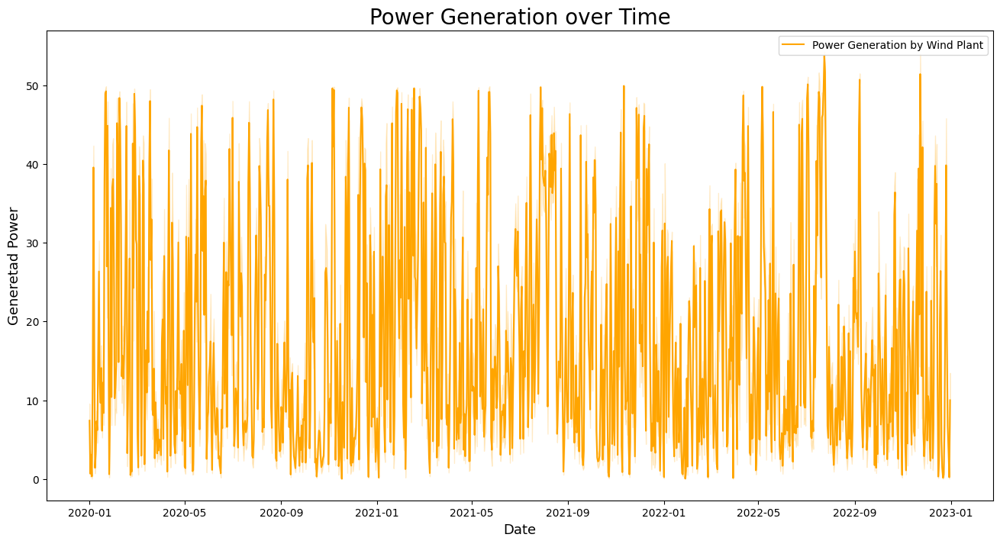

In [13]:
# Draw a basic plot of the data to get a sense of the data and its properties
f, ax = plt.subplots(figsize=(16,8))
sns.lineplot(data=train_df,x = pd.to_datetime(train_df['datetime']).dt.date,y = 'prod', color='orange',label='Power Generation by Wind Plant')
ax.set_title('Power Generation over Time', fontsize=20)
ax.set_ylabel('Generetad Power', fontsize=13)
ax.set_xlabel('Date', fontsize=13)
plt.legend(fontsize=10)
plt.show()

## Initial Data Analysis

Upon initial inspection, several characteristics of the data are apparent:

1. **Non-stationarity**: The data does not appear to be stationary, as the mean and variance are not constant over time.

3. **Absence of a clear trend**: The data does not exhibit a clear trend. However, there are numerous spikes in the data.

These spikes warrant further investigation to understand their underlying causes.

## Feature Engineering from DateTime Column

The function `datetime_feature_engineering(df)` is designed to extract and create new features from the 'datetime' column of the input DataFrame. These features are expected to provide additional insights that could be useful for our model and enhance data visualization.

The function performs the following operations:

1. **Convert 'datetime' column to datetime object**: This conversion is necessary to enable the extraction of specific components like hour, month, year, etc.

2. **Create 'hour' feature**: This feature represents the hour of the day and can help capture daily patterns in power plant production.

3. **Create 'month' feature**: This feature represents the month of the year and can help capture monthly patterns in power plant production.

4. **Create 'year' feature**: This feature represents the year and can help capture any long-term trends in power plant production.

5. **Create 'season' feature**: This feature categorizes the months into four seasons: Winter, Spring, Summer, and Autumn. This can help capture seasonal patterns in power plant production.

6. **Create 'day_of_week' feature**: This feature represents the day of the week and can help capture weekly patterns in power plant production.

7. **Create 'is_weekday' feature**: This binary feature indicates whether a day is a weekday (Monday to Friday) or not. This can help capture patterns related to the difference in power plant production between weekdays and weekends.

By creating these features, we aim to better understand the temporal patterns and trends in the power plant production data. We will visualize these features to determine if any specific time intervals or frames are strongly associated with power production.

In [14]:
train_df = datetime_feature_engineering(train_df)

/var/folders/5s/1kvy18b544sfm3b036mk03140000gn/T/ipykernel_3363/148700978.py:14: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  plot_intervals = [train_df['datetime'].dt.dayofyear, train_df['datetime'].dt.week, train_df['datetime'].dt.month, train_df['season']]


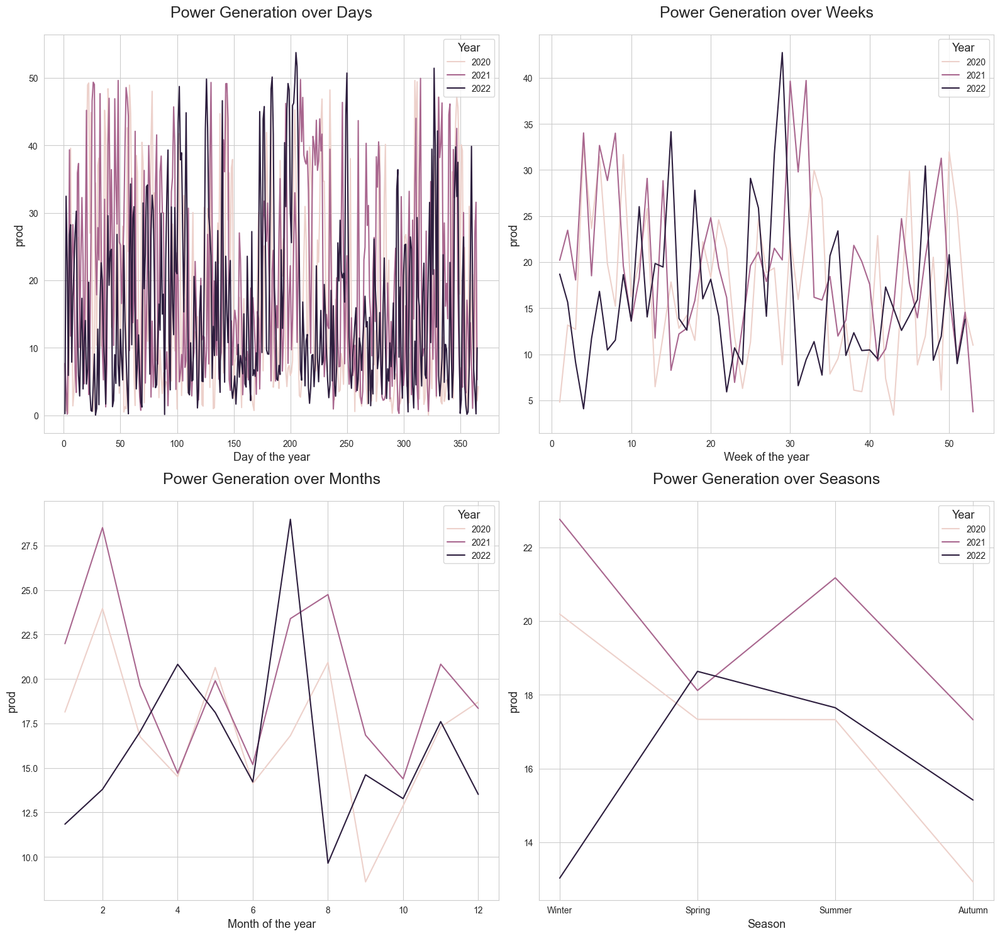

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style of the plot to be white background with grid
sns.set_style("whitegrid")

# Create a subplot with 2 rows and 2 columns
f, ax = plt.subplots(nrows=2, ncols=2, figsize=(16, 15))

# Flatten the axes array
ax = ax.flatten()

# Setting the plot intervals and necessary titles for the plot
plot_intervals = [train_df['datetime'].dt.dayofyear, train_df['datetime'].dt.week, train_df['datetime'].dt.month, train_df['season']]
titles = ['Power Generation over Days', 'Power Generation over Weeks', 'Power Generation over Months', 'Power Generation over Seasons']
xlabels = ['Day of the year', 'Week of the year', 'Month of the year', 'Season']

# Plotting the data
for i in range(len(plot_intervals)):
    sns.lineplot(data=train_df, x=plot_intervals[i], y='prod', hue='year', ax=ax[i],errorbar=None)
    ax[i].set_title(titles[i], fontsize=18, pad=20)
    ax[i].set_ylabel('prod', fontsize=13)
    ax[i].set_xlabel(xlabels[i], fontsize=13)
    
    # Adjust legend
    ax[i].legend(title='Year', title_fontsize='13', loc='upper right')

plt.tight_layout()
plt.show()

## Initial Observations on Different Time Intervals

Upon initial inspection of the power generation data at different time intervals, several observations can be made:

1. **Daily Interval**: The daily interval data appears to be noisy and challenging to interpret.

2. **Weekly Interval**: The weekly interval data is more stable and easier to interpret. It suggests a weekly seasonality in power generation. However, the degree of change varies, especially in 2022.

3. **Yearly Patterns**: The data for 2020 and 2021 exhibit similar patterns. However, the winter season of 2022 has significantly lower power production compared to previous years. Additionally, a notable decrease in power production is observed in August 2022 compared to the same period in 2020 and 2021.

Despite these changes, the seasonal pattern for spring and autumn remains consistent across the years. This consistency could provide valuable insights for our model.

## Next Steps

We will further investigate the hourly data to identify any hourly seasonality. Additionally, we will continue to analyze the patterns between the years to understand the factors contributing to high and low power production periods. Specifically, we will inspect the winter season of 2022 and August across all years to uncover the underlying reasons for the observed low production.

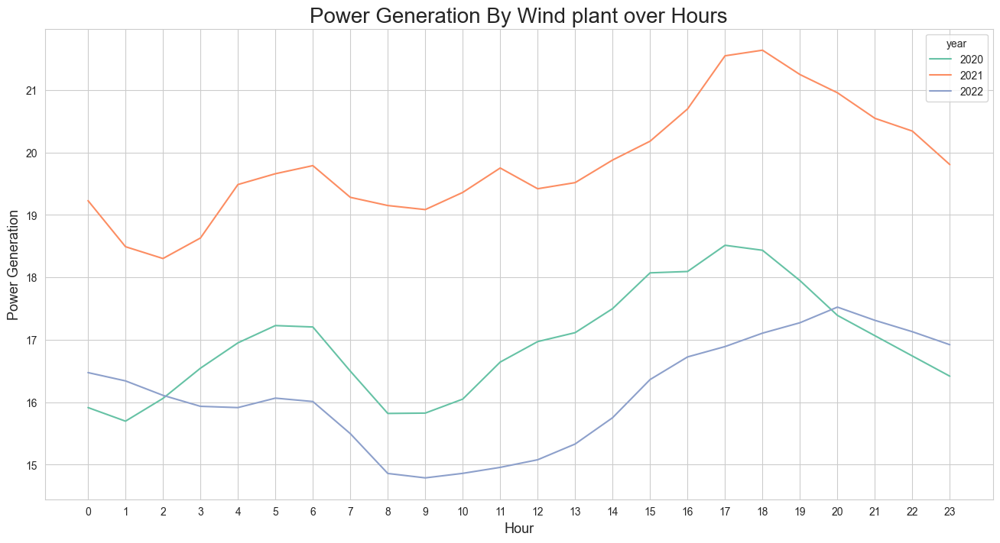

In [16]:
# Hourly Demand -  for years
f, ax = plt.subplots(figsize=(16,8))
sns.lineplot(data=train_df,x = 'hour',y = 'prod', hue='year', palette='Set2', errorbar=None)
ax.set_title('Power Generation By Wind plant over Hours', fontsize=20)
ax.set_ylabel('Power Generation', fontsize=13)
ax.set_xlabel('Hour', fontsize=13)
_ = ax.set_xticks(range(0,24))

## Observations on Hourly Power Generation

Upon examining the hourly power generation data for the wind plant, several observations can be made:

1. **Stability of Power Generation**: The power generation appears to be more stable compared to other time periods we have analyzed. This stability might serve as a good indicator for our model.

2. **Stable Hour Periods**: The power generation change is relatively stable across the years for certain hour periods, specifically 4-11, 12-17, and 20-23. However, for other time intervals, the power generation is more volatile.

3. **Yearly Comparisons**: The power generation patterns for 2020 and 2021 are very similar, with minor differences in the degree of change from 2 am to 11 pm. However, in 2022, variations are observed in the 2-4 and 18-20 time intervals compared to 2020 and 2021. also this might happen  because between 16-18 as not high as supposed to be fore 2022 



## Next Steps

These observations highlight the need to further investigate the changes occurring between these specific hours in 2022 compared to 2021 and 2020. Understanding these changes could provide valuable insights for our model.  


In [17]:
train_df['hour_periods'] = train_df['hour'].apply(hour_periods)

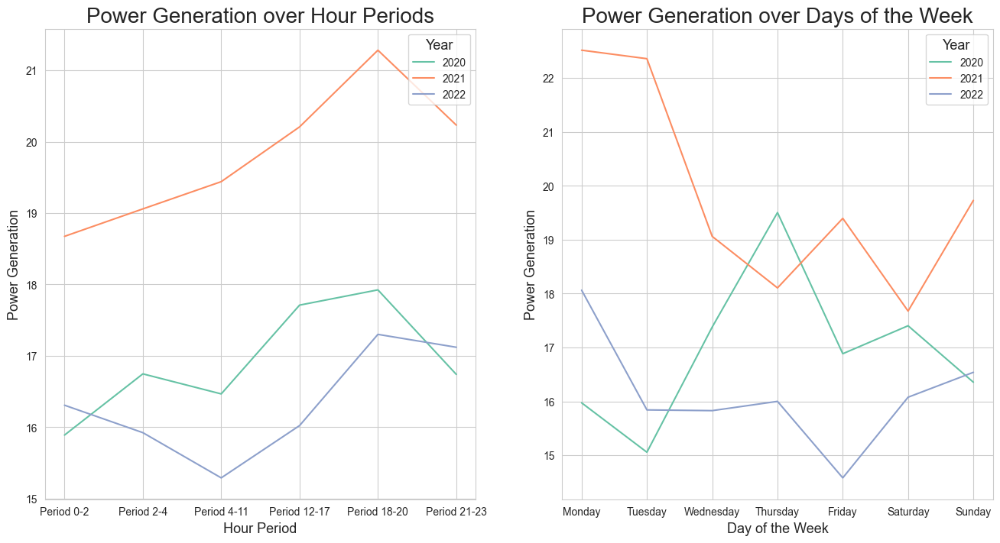

In [18]:
# Visualize the power generation for each hour period, also visualizing day of the week for year
f, ax = plt.subplots(nrows=1,ncols=2,figsize=(16,8))
period = ['hour_periods','day_of_week']
titles = ['Power Generation over Hour Periods', 'Power Generation over Days of the Week']
xlabels = ['Hour Period', 'Day of the Week']
for i in range(len(period)):
    sns.lineplot(data=train_df,x = period[i],y = 'prod', hue='year', palette='Set2', errorbar=None, ax=ax[i])
    ax[i].set_title(titles[i], fontsize=20)
    ax[i].set_ylabel('Power Generation', fontsize=13)
    ax[i].set_xlabel(xlabels[i], fontsize=13)
    ax[i].legend(title='Year', title_fontsize='13', loc='upper right')

## Hour Period Analysis

Upon examining the data across different hour periods, a clear relationship emerges. The power generation changes consistently between 4 pm to 11 pm, despite varying degrees. This pattern is the most distinct among all the time intervals we have analyzed so far, one way to use this idea could be training each model on their on period of time and then ensemble the results , or there could be mean of the hour periods as a feature to hour model but this can only be used in an hourly or other time interval setup, which does not suit or case very well so we would be dropping the hour period for this particular forecasting challenge

## Day of the Week Analysis

In contrast, the day of the week analysis reveals inconsistencies in the data. The degree of change in power generation is highly unstable across different years, making it difficult to discern any clear patterns. Due to this instability, we have decided not to include this feature in our model.

## Feature Selection: Datetime Features

From our analysis, it appears that the hour period and the hour of the day are the most significant datetime features in terms of power generation. Other datetime intervals do not show any significant difference in power generation and are unlikely to provide any additional information to the model. 

Therefore, we will proceed with dropping these less significant datetime features from our dataset.

In [19]:
train_df.drop(columns=['month','day_of_week','is_weekday','hour_periods'],inplace=True)

## Creation of Lagged Features

Given the strong correlation between the hour and power generation, we will enhance our model by creating lagged features. These features will be based on the power generation from the same hour for the last three days and the last two weeks. 

This approach serves two purposes:

* It helps prevent overfitting by introducing more variability into the model.
* It provides the model with additional information, potentially improving its predictive performance.

The lagged features will represent the power generation from 24, 48, 72 hours, and 1 and 2 weeks prior.

In [20]:
train_df = create_lagged_features(train_df, 'prod')

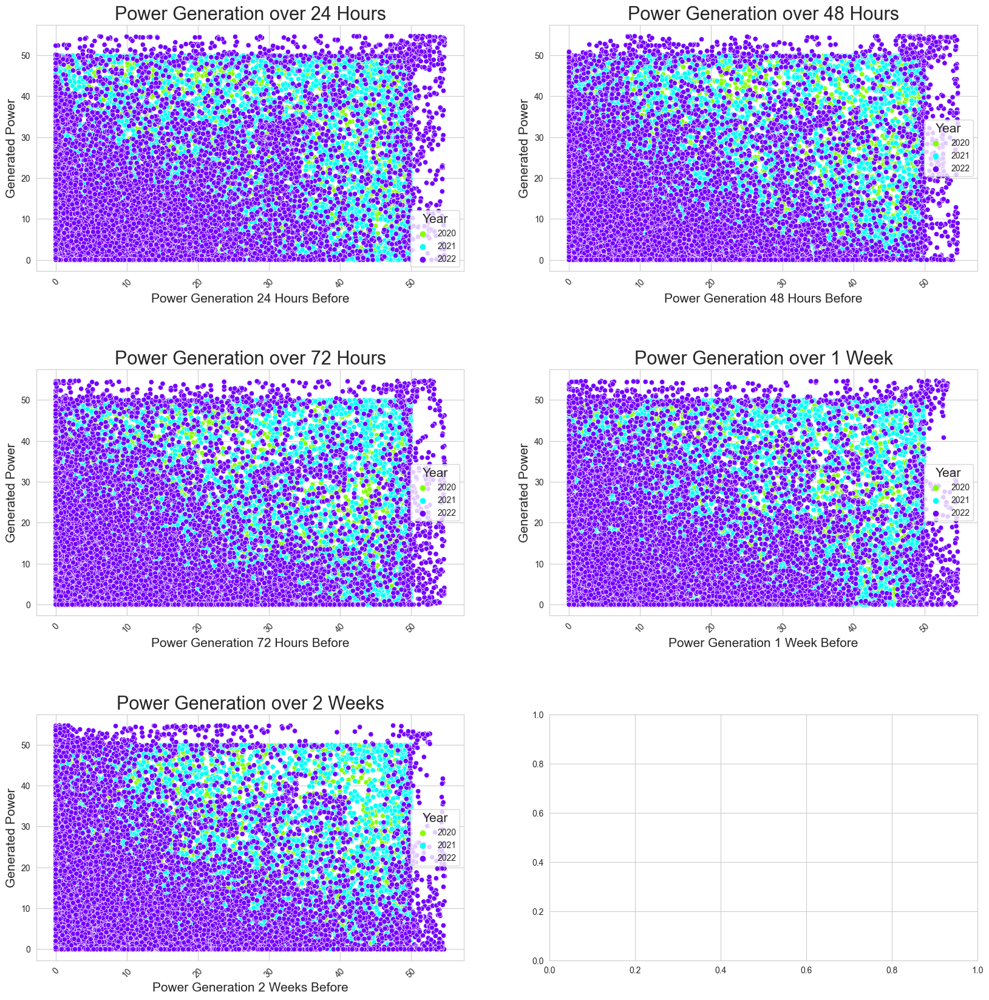

In [21]:
# Visualize the relationship between the demand and the lagged features
f, ax = plt.subplots(nrows=3, ncols=2, figsize=(20, 20))  # Increase figure size
ax = ax.ravel()  # Flatten the ax array
lagged_features = ['prod_lag_24', 'prod_lag_48', 'prod_lag_72', 'prod_lag_168', 'prod_lag_336']
titles = ['Power Generation over 24 Hours', 'Power Generation over 48 Hours', 'Power Generation over 72 Hours', 'Power Generation over 1 Week', 'Power Generation over 2 Weeks']
xlabels = ['Power Generation 24 Hours Before', 'Power Generation 48 Hours Before', 'Power Generation 72 Hours Before', 'Power Generation 1 Week Before', 'Power Generation 2 Weeks Before']

# Define a color palette
palette = sns.color_palette("hsv", len(train_df['year'].unique()))

for i in range(len(lagged_features)):
    sns.scatterplot(data=train_df, x=lagged_features[i], y='prod', hue='year', ax=ax[i], palette=palette)
    ax[i].set_title(titles[i], fontsize=22)  # Increase font size
    ax[i].set_ylabel('Generated Power', fontsize=15)  # Increase font size
    ax[i].set_xlabel(xlabels[i], fontsize=15)  # Increase font size
    ax[i].legend(title='Year', title_fontsize='15', loc='best')
    plt.setp(ax[i].xaxis.get_majorticklabels(), rotation=45)  # Rotate x-axis labels

plt.subplots_adjust(hspace=0.4)  # Adjust the space between subplots

## Analysis of Lagged Values

From the above graphs, it is evident that the lagged values from the previous day do not provide significant value in forecasting power generation. This observation aligns with the irregularities we have noticed in the data, characterized by the spikes.

This suggests that the power generation does not follow a clear pattern from day to day. Therefore, our model's effectiveness will likely depend more on the correlation between the variables and the impact of weather conditions, which are critical factors in power generation.

In [22]:
# we will be dropping the lagged features for 24, 48, 72 hours and 1, 2 weeks as we wont be using them in our model 
train_df = remove_lagged_features(train_df, 'prod', [24, 48, 72, 24*7, 2*24*7])
train_df.drop(columns=['year'],inplace=True)

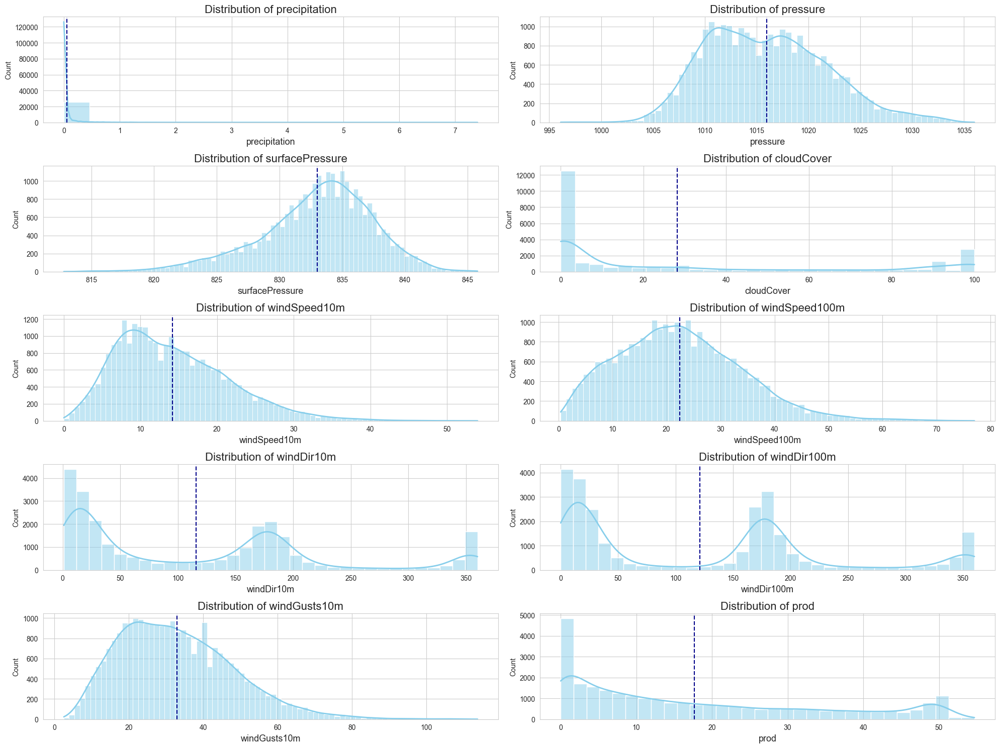

In [23]:
import seaborn as sns
import matplotlib.pyplot as plt

f, ax = plt.subplots(nrows=5, ncols=2, figsize=(20, 15))
ax = ax.ravel()  # Flatten the ax array

continuous_variables = ['precipitation','pressure','surfacePressure','cloudCover','windSpeed10m','windSpeed100m','windDir10m','windDir100m','windGusts10m','prod']

for i in range(len(continuous_variables)):
    sns.histplot(train_df[continuous_variables[i]], ax=ax[i], kde=True, color='skyblue', 
                 line_kws={'linewidth':2, 'color':'red'})
    ax[i].axvline(train_df[continuous_variables[i]].mean(), color='darkblue', linestyle='--')
    ax[i].set_title(f'Distribution of {continuous_variables[i]}', fontsize=16)
    ax[i].set_xlabel(continuous_variables[i], fontsize=13)

plt.tight_layout()

## Initial Observations on Distributions

Upon initial inspection of the distributions, several observations can be made:

1. **Precipitation**: The distribution of precipitation exhibits strong right skewness and a high mean value. If there were any missing values, the median would have been a more appropriate measure to fill them due to the skewness.

2. **Wind Gusts and Wind Speeds**: The distributions of `windgusts10m`, `windspeed10m`, and `windspeed100m` are right-skewed but resemble a normal distribution. This could be a positive sign for our model as these variables might provide a stable factor.

3. **Cloud Cover**: The cloud cover distribution has many outliers. The impact of these outliers on power production (`prod`) will be investigated in subsequent plots.

4. **Wind Direction**: TThe distributions of both wind direction (`winddir10m` and `winddir100m`) and wind speed (`windspeed10m` and `windspeed100m`) are strikingly similar at these respective heights. This pattern suggests a potential to estimate the volume of wind passing through at ground level (0 meters) based on the wind direction and speed. In the forthcoming sections, we will delve deeper into this hypothesis with further plots and calculations, aiming to understand its alignment with power production.

These initial observations provide a foundation for our further analysis and model development.


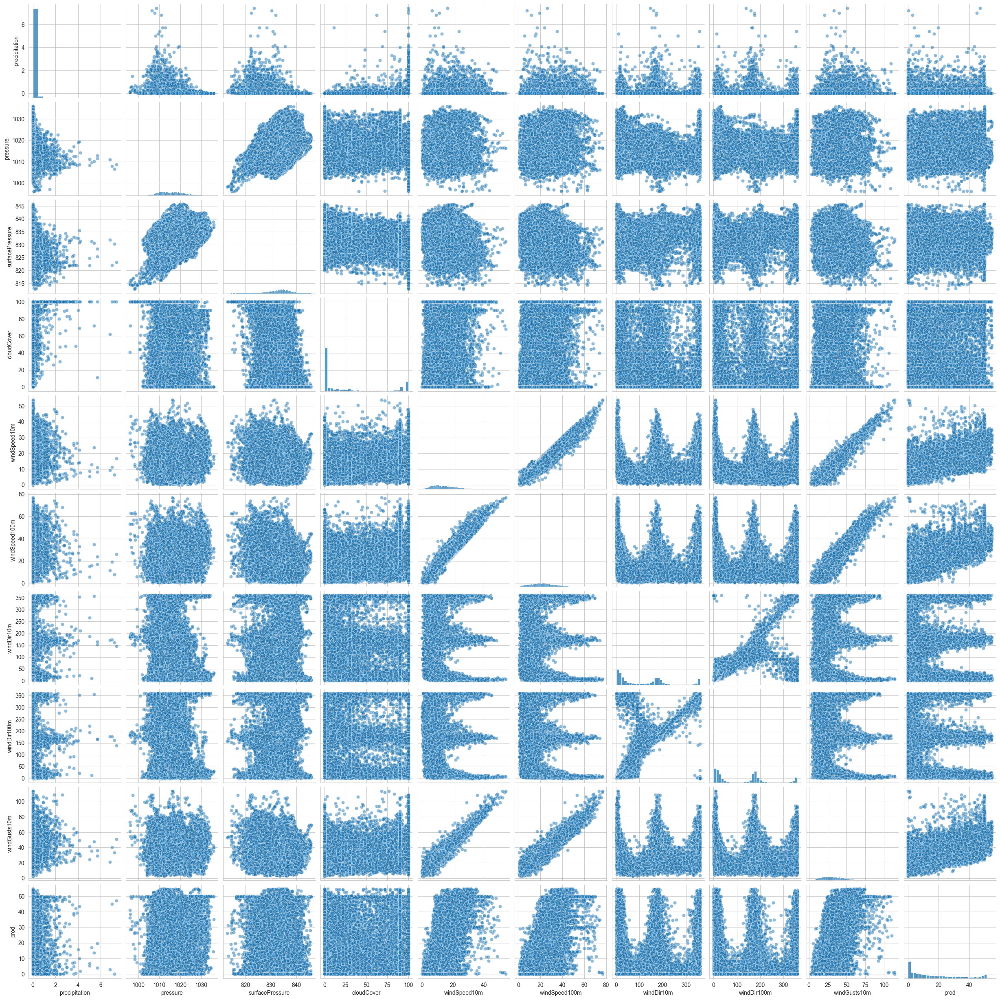

In [24]:
import seaborn as sns

# Select only the continuous variables
continuous_variables = ['precipitation','pressure','surfacePressure','cloudCover','windSpeed10m','windSpeed100m','windDir10m','windDir100m','windGusts10m','prod']

df_continuous = train_df[continuous_variables]

# Create pair plots
sns.pairplot(df_continuous, plot_kws={'alpha': 0.5})

/var/folders/5s/1kvy18b544sfm3b036mk03140000gn/T/ipykernel_3363/1634072329.py:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = train_df.corr()


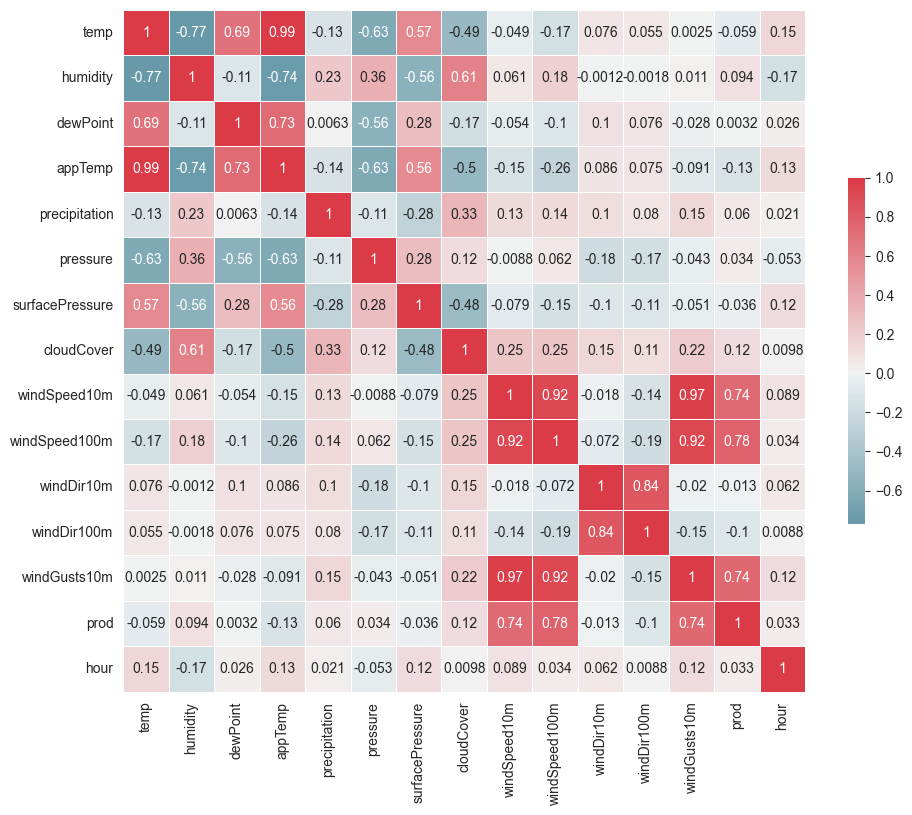

In [25]:
import seaborn as sns
import matplotlib.pyplot as plt

# Compute the correlation matrix
corr = train_df.corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the correct aspect ratio
sns.heatmap(corr, cmap=cmap, center=0, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.show()

## Correlation Analysis

From the heatmap, we can observe several significant correlations in our dataset:

1. **Wind Speed Features**: The wind speed features are highly correlated with each other and also with the target variable. This suggests that wind speed has a strong influence on power production.

2. **Wind Direction Features**: The wind direction features are highly correlated with each other. This indicates that the wind direction at different heights are usually similar.

3. **Temperature and Apparent Temperature**: The actual temperature and the 'feels like' temperature (apparent temperature) are highly correlated (0.99). If these two features do not provide unique information, we might consider removing one of them to reduce redundancy.

4. **Pressure and Temperature**: There is a strong negative correlation between atmospheric pressure and temperature. This is consistent with the physical principle that temperature decreases with altitude (and thus with increasing pressure).

5. **Cloud Cover and Humidity**: Cloud cover has a high correlation with humidity values. This makes sense as both are related to the amount of moisture in the air.

In the next steps, we will further investigate these correlations and consider how to handle them in our predictive model.

# Wind Energy Feature Engineering

In this section, we will discuss three functions that are used for feature engineering in the context of wind energy production. These functions are designed to create new features that might help improve the performance of our predictive models given the high correlation between wind features and the target variable.

## 1. Wind Speed Differential

**Function:** `wind_speed_differential(data)`

The `wind_speed_differential` function calculates the difference in wind speed at two different heights: 100 meters and 10 meters. This difference is important because wind speed can vary significantly with altitude. The function takes a DataFrame as input, which should contain the columns 'windspeed100m' and 'windspeed10m'. It calculates the difference between these two columns and stores the result in a new column 'wind_speed_diff'. 

## 2. Wind Gust Impact

**Function:** `wind_gust_impact(data)`

The `wind_gust_impact` function calculates the impact of wind gusts on power production. Wind gusts can have a significant impact on power production. A gust of wind can cause a sudden increase in wind speed, leading to a spike in power production. However, if the gust is too strong, it can also cause damage to the wind turbine. The function calculates the impact of wind gusts by subtracting the average wind speed from the gust speed. The average wind speed is calculated as the average of the wind speeds at 100m and 10m. The result is stored in a new column 'wind_gust_impact'.

## 3. Directional Efficiency

**Function:** `directional_efficiency(data, column_names, direction_bins=None, direction_labels=None)`

The `directional_efficiency` function categorizes wind direction into segments and analyzes how each segment correlates with power production. The function takes a DataFrame as input, which should contain the wind direction columns specified in `column_names`. It segments the wind direction data into bins specified by `direction_bins` and labels them using `direction_labels`. The segmented wind direction data is stored in new columns in the DataFrame.

In [26]:
train_df = wind_gust_impact(train_df)
train_df = wind_speed_differential(train_df)
train_df = directional_efficiency(train_df,column_names=['windDir10m','windDir100m'])

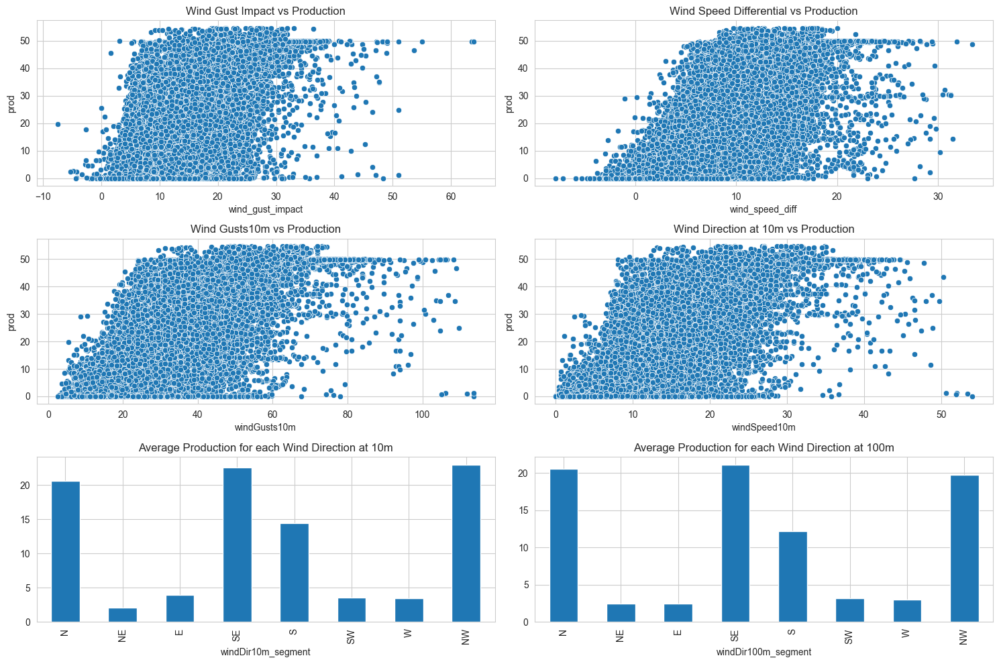

In [27]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, axs = plt.subplots(3, 2, figsize=(15, 10))

# Scatter plot for wind_gust_impact vs prod
sns.scatterplot(x='wind_gust_impact', y='prod', data=train_df, ax=axs[0, 0])
axs[0, 0].set_title('Wind Gust Impact vs Production')

# Scatter plot for wind_speed_diff vs prod
sns.scatterplot(x='wind_speed_diff', y='prod', data=train_df, ax=axs[0, 1])
axs[0, 1].set_title('Wind Speed Differential vs Production')

sns.scatterplot(x='windGusts10m', y='prod', data=train_df, ax=axs[1, 0])
axs[1, 0].set_title('Wind Gusts10m vs Production')

sns.scatterplot(x='windSpeed10m', y='prod', data=train_df, ax=axs[1, 1])
axs[1, 1].set_title('Wind Direction at 10m vs Production')

# Count plot for windDir10m_segment
train_df.groupby('windDir10m_segment')['prod'].mean().plot(kind='bar', ax=axs[2, 0])
axs[2, 0].set_title('Average Production for each Wind Direction at 10m')

# Bar plot for average production per windDir100m_segment
train_df.groupby('windDir100m_segment')['prod'].mean().plot(kind='bar', ax=axs[2, 1])
axs[2, 1].set_title('Average Production for each Wind Direction at 100m')
plt.tight_layout()
plt.show()


## Observations on Power Production and Wind Direction

From our analysis, it appears that power production is higher when the wind direction is either north (N), southeast (SE), or northwest (NW) for both wind direction measurements. The south (S) direction comes in second in terms of power production, while the remaining directions yield significantly lower production.

Although the graphs for both wind direction measurements are quite similar and seem to contain similar information, there could be more complex relationships hidden in the combination of these two variables. We will further analyze this potential interaction to see if it can provide additional insights that could improve our predictive model.

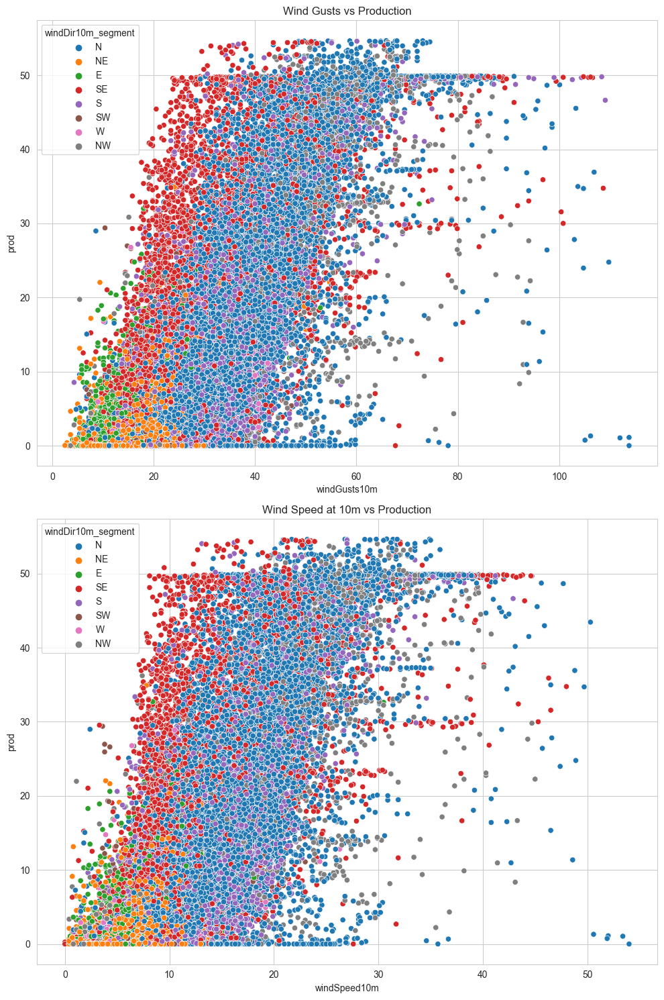

                    windGusts10m  windSpeed10m       prod
windDir10m_segment                                       
N                      37.638172     16.250089  20.605125
NE                     16.565209      6.631843   2.150713
E                      14.373692      6.237604   3.944337
SE                     31.056691     13.662405  22.585358
S                      33.015667     14.050441  14.451754
SW                     22.712939      8.088158   3.616579
W                      22.400000      7.559028   3.491493
NW                     41.795969     18.421761  23.003760


In [28]:
# Some windgusts and windspeed values might come of from wrong direction which might be the couse of low power generation lets try to visualize and see if our theory is correct
visualize_and_analyze_winddir_with_windgusts_speed(train_df)

## Analysis of Wind Direction Impact on Power Generation

From the plot above, we observe that certain wind directions result in lower power generation, despite their relatively low occurrence. This is likely due to the strategic positioning and location of the wind plant, which is designed to maximize power generation from the most prevalent wind directions.

In the upcoming sections, we will further visualize these wind direction data. Our aim is to devise strategies that could potentially enhance power generation, even from less optimal wind directions.

## Analysis of Variable Distributions for Different Production Levels

We aim to create distribution plots for the lower ~50% and higher ~50% of production values. By comparing these distributions, we can identify which variables change the most or least. This information can be useful for adjusting the weights of these variables in our model, focusing more on the variables that change significantly, or simplifying our data by ignoring the variables that change very little.

In addition, if we find that some variables, such as 'app_temp' and 'temp', are highly correlated (e.g., correlation > 0.98), we might consider combining them into a single feature. This is because they are likely not providing much new information to our model when used separately.

Statistics for production over 25:
              temp     humidity     dewPoint      appTemp  precipitation  \
count  7892.000000  7892.000000  7892.000000  7892.000000    7892.000000   
mean      7.865180    64.897618     0.235783     3.068905       0.072973   
std       9.365444    24.531807     5.644674    10.211143       0.300185   
min     -14.700000    11.000000   -18.900000   -22.600000       0.000000   
25%       1.200000    43.000000    -2.900000    -3.900000       0.000000   
50%       7.000000    67.000000     0.900000     2.200000       0.000000   
75%      15.400000    87.000000     4.000000    11.400000       0.000000   
max      31.300000   100.000000    14.400000    28.300000       7.400000   

          pressure  surfacePressure   cloudCover  windSpeed10m  windSpeed100m  \
count  7892.000000      7892.000000  7892.000000   7892.000000    7892.000000   
mean   1016.357349       832.720261    34.258870     21.138609      33.857223   
std       6.313981         4.541734  

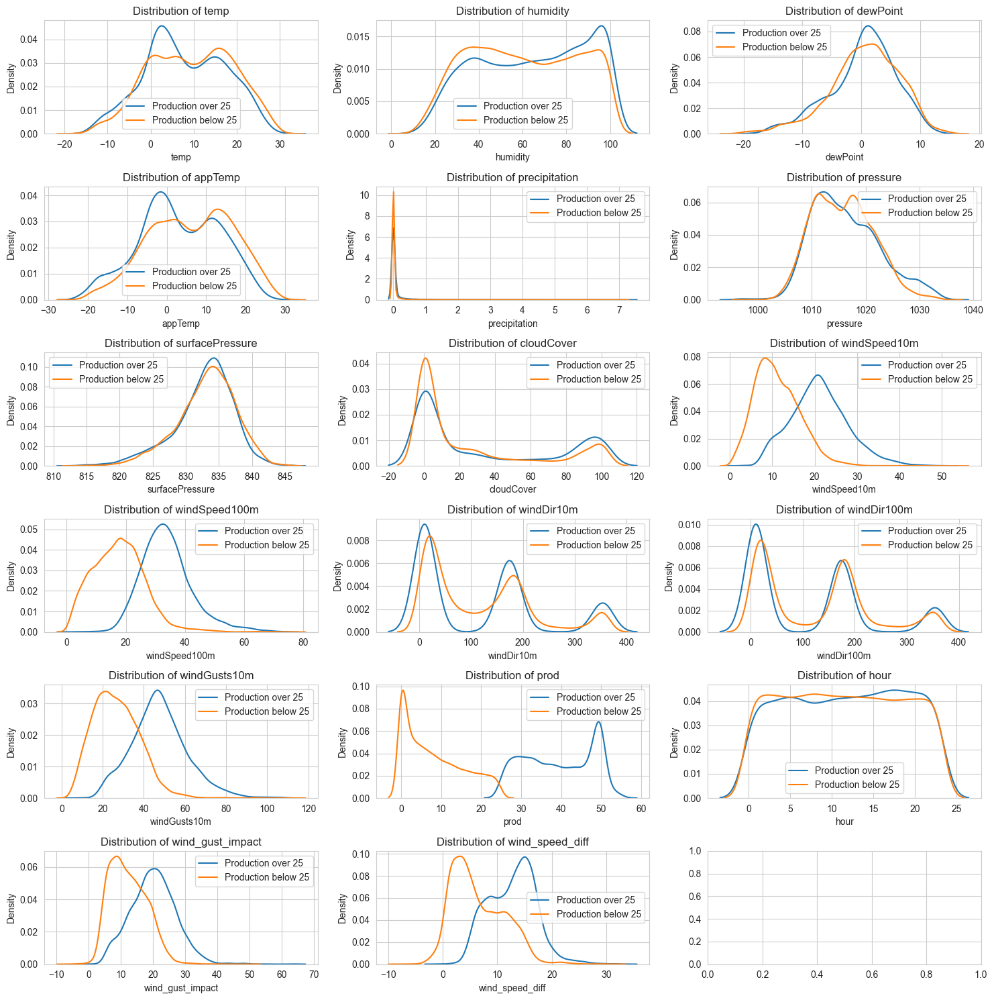

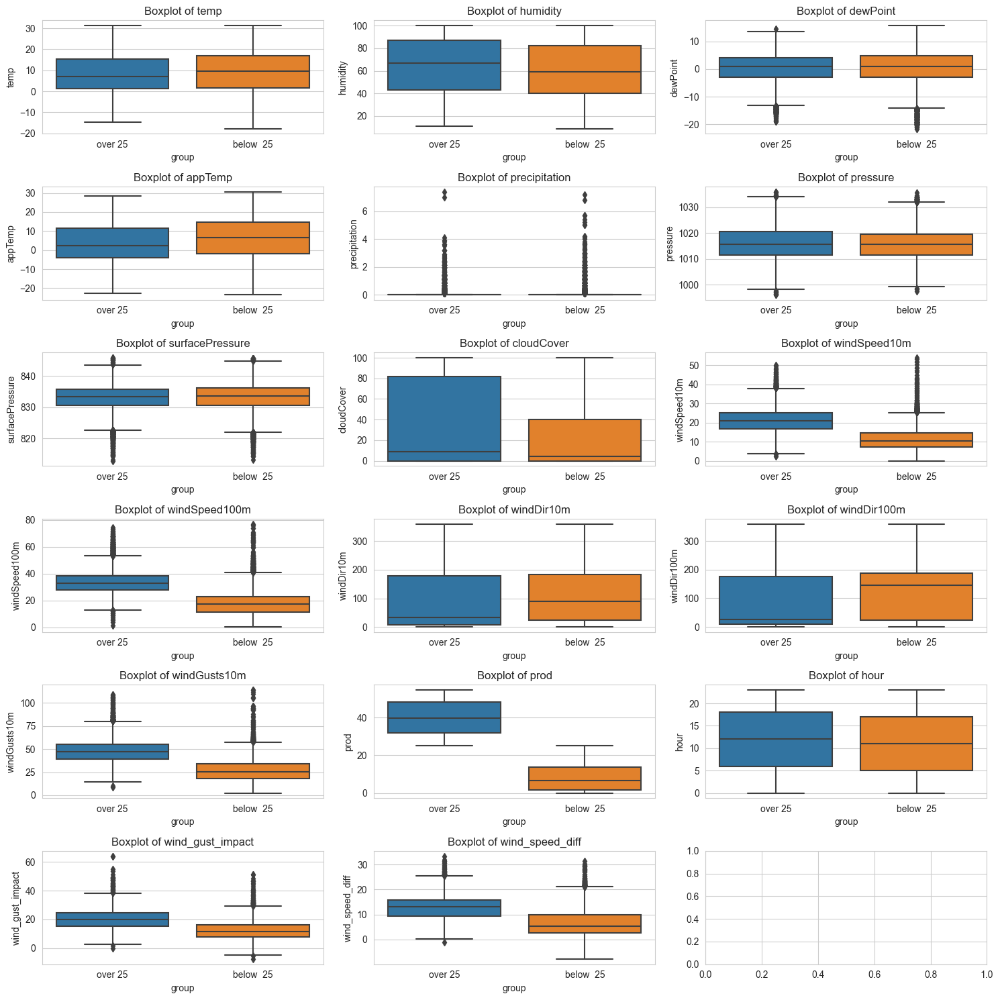

In [29]:
import matplotlib.pyplot as plt
import seaborn as sns

# Split the data
data_over_30 = train_df[train_df['prod'] > 25]
data_below_30 = train_df[train_df['prod'] <= 25]

# Calculate and print statistical values for numeric columns
numeric_columns = train_df.select_dtypes(include=['int64', 'float64']).columns


print("Statistics for production over 25:")
print(data_over_30[numeric_columns].describe())

print("\nStatistics for production below or equal to 25:")
print(data_below_30[numeric_columns].describe())

# Calculate and print mode for object category columns
category_columns = train_df.select_dtypes(include=['object']).columns

print("\nMode for production over 25:")
print(data_over_30[category_columns].mode())

print("\nMode for production below or equal to 25:")
print(data_below_30[category_columns].mode())

# Visualize the distributions
fig, axs = plt.subplots(len(numeric_columns) // 3 + 1, 3, figsize=(15, 15))

for i, column in enumerate(numeric_columns):
    sns.kdeplot(data_over_30[column], ax=axs[i // 3, i % 3], label='Production over 25')
    sns.kdeplot(data_below_30[column], ax=axs[i // 3, i % 3], label='Production below 25')
    axs[i // 3, i % 3].set_title(f'Distribution of {column}')
    axs[i // 3, i % 3].legend()

plt.tight_layout()
plt.show()

# Boxplot version
fig, axs = plt.subplots(len(numeric_columns) // 3 + 1, 3, figsize=(15, 15))

for i, column in enumerate(numeric_columns):
    sns.boxplot(x='group', y=column, data=pd.concat([data_over_30.assign(group='over 25'), data_below_30.assign(group='below  25')]), ax=axs[i // 3, i % 3])
    axs[i // 3, i % 3].set_title(f'Boxplot of {column}')

plt.tight_layout()
plt.show()

## Key Observations from the Data Analysis

From our exploratory data analysis, several key insights emerge:

1. **Wind Speed and Wind Gusts**: These appear to be the most critical features for power generation with no suprise. The distribution plots show a clear correlation between these variables and the power output.

2. **Weather Conditions**: Variables such as temperature, cloud cover, humidity, and dew point also influence power generation. The distribution differences between lower and higher production levels indicate these variables' impact.

3. **Wind Direction**: The wind direction tends to be towards the Southeast (SE), Northwest (NW), and North (N) for higher power generation values. This observation suggests that wind direction could be a significant factor in power generation as we have shown on the previous plots.

4. **Time of Day**: The hour of the day also seems to slightly affect power generation as we have shown in the previous plots. The boxplot shows a slightly higher power generation during certain hours.

These observations will guide us in feature selection and engineering for our predictive model. By focusing on the variables that significantly impact power generation, we can build a more accurate and efficient model.



## Outlier Analysis on Power Generation


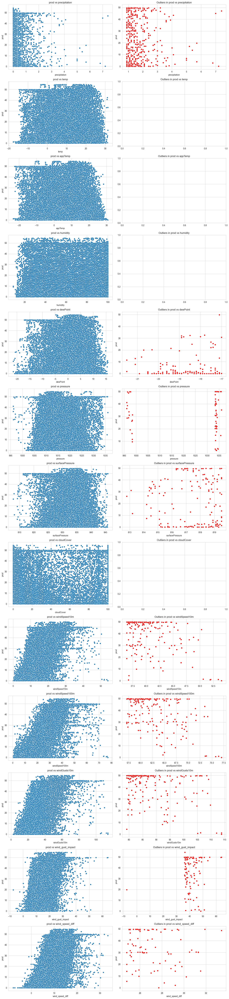

In [30]:
# Outlier Analysis on power production 
continuous_variables = ['precipitation','temp','appTemp','humidity','dewPoint','pressure','surfacePressure','cloudCover','windSpeed10m','windSpeed100m','windGusts10m','wind_gust_impact','wind_speed_diff']
plot_continuous_outlier_variables(df = train_df,continuous_variables= continuous_variables,target_col='prod')

# Outlier Analysis Summary

Our analysis of outliers in the dataset reveals several key insights:

- **No Outliers**: Some columns in the dataset do not exhibit any outliers. This suggests that the data in these columns is relatively consistent.

- **Dewpoint**: For the 'dewpoint' column, outliers tend to fall below 10 prod. These outliers could potentially be beneficial for our predictive model, as they may represent unique conditions that affect wind power production.

- **Pressure**: Outliers in the 'pressure' column also appear to be not erroneous but potentially informative for our model. 

- **Wind-Related Columns**: For columns related to wind, outliers seem to provide valuable information. Notably, production rates generally increase with these outlier values, suggesting a positive correlation between these features and the target variable.

Based on these observations, we have decided not to smooth or remove outliers for our predictive models. Instead, we will incorporate these potentially informative outliers into our model training process.

## Analyzing Wind Direction Combination for Power Production

In this section, we aim to analyze the combination of `windDir100m` and `windDir10m` to understand their impact on power production. While it's clear that certain wind directions do not yield high power 
production, the interaction between these two features might provide additional insights.

The goal is to explore if we can represent the wind direction in a more effective way by combining these two features. This could potentially enhance our predictive model's performance by capturing the complex relationship between wind direction at different altitudes and power production.

We will create a new feature that combines `windDir100m` and `windDir10m`, and then analyze the average power production for each unique combination. This will help us understand if certain combinations of wind direction at 100m and 10m altitudes are more favorable for power production.

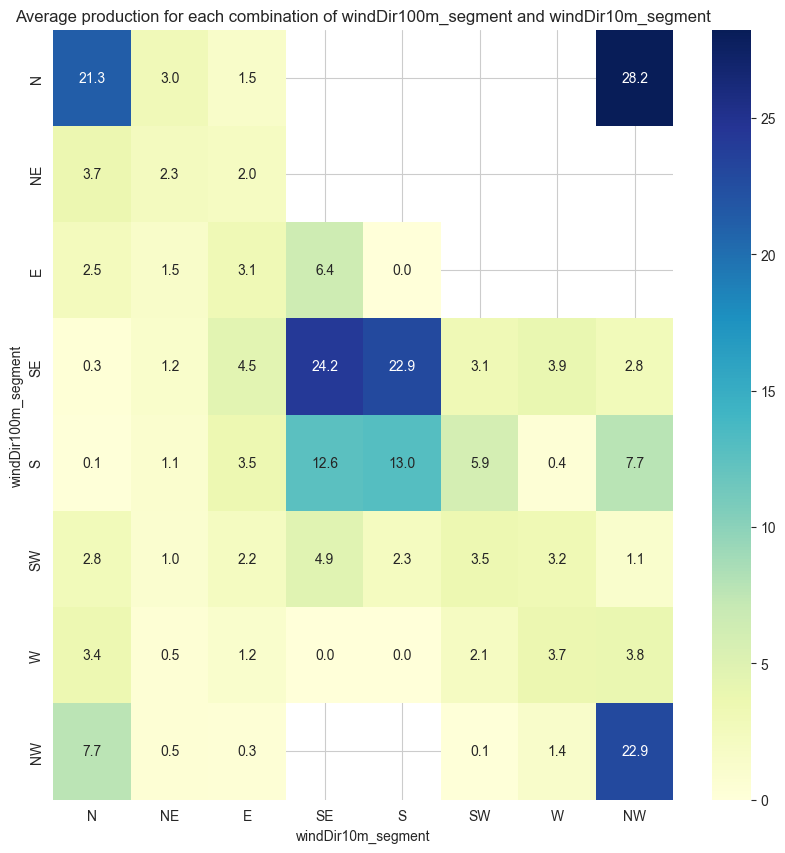

In [31]:
# Create a pivot table
pivot_table = pd.pivot_table(train_df, values='prod', index='windDir100m_segment', columns='windDir10m_segment', aggfunc='mean')

# Create a heatmap
plt.figure(figsize=(10, 10))
sns.heatmap(pivot_table, annot=True, fmt=".1f", cmap="YlGnBu")
plt.title('Average production for each combination of windDir100m_segment and windDir10m_segment')
plt.show()

## Further Analysis of Wind Direction for Power Production

From our heatmap, it's clear that the categories of wind direction provide valuable insights. In our previous analysis, we found that the southeast (SE) direction is optimal for power generation, as it also yields the highest overall mean production.

However, it's interesting to note that the combinations of northwest (NW) and north (NW - N) show a significant difference of ~20% in production. Furthermore, certain combinations, such as NW-S and NW-N, yield the same mean production. This suggests that the interaction between these two features could be important.

The production values are densely packed (e.g., 3.5, 3.2, 3.5, 3.7), indicating that creating a new feature by combining these two might be beneficial. This could help reduce the complexity of the model, especially for decision-tree based models or neural networks, where the simultaneous presence of both variables might not significantly impact the decision-making process.

Looking at the data, the production values are mostly concentrated in the ranges 0-2.5, 2.5-4, 4-10, 10-20, 20-22, 22-24, 24-26, and 26+. Therefore, binning the values in these ranges seems appropriate as it captures the distribution of the data better than uniform binning.

Finally, to handle the increased dimensionality resulting from the creation of this new feature, we will use one hot encoding, as the dimensions are not that high and tree based models work well with one hot encoding plus with binary encoding its hard to interpret the results after the getting the predictions 
   

In [32]:
train_df = create_binned_direction_feature(train_df, bins = [0, 2.5, 4, 10, 20, 22, 24, 26, float('inf')],drop = True,is_train=True)


## Feature Engineering: Combining Highly Correlated Features

To simplify our model and reduce the dimensionality of our data, we will combine highly correlated features into a single feature. Specifically, we will combine 'appTemp' (or 'tempfeelslike') and 'temperature', which have a correlation of 98%.

Since these two features are so highly correlated, they likely do not provide much unique information to our model when used separately. By averaging them, we can create a new feature, 'temp_avg', that captures the same information in a more compact form.

After creating 'temp_avg', we will drop 'appTemp' and 'temperature' from our dataset. This process will help us keep our model simple and focused on the most informative features.


In [33]:
train_df = create_avg_temp(train_df)

## Encoding The Categoical Features

In [34]:
# Encode the  variables using one hot encoding 
train_df = categorical_encoding(train_df,categorical_variables=['windDir_comb_binned','season']) 

## Cyclic Encoding of 'Hour' Variable

The 'hour' variable is a cyclical feature as it follows a cycle of 24 hours. After the 23rd hour, the cycle doesn't progress to the 24th hour, but instead resets back to 0. 

Traditional numerical encoding could lead the model to learn incorrect associations, such as hour '0' being very different from hour '23', while in reality they are very close to each other (only 1 hour apart).

Cyclic encoding helps to preserve this cyclical nature by mapping each hour to a point on a circle. This way, the distance between each hour is proportional to the time difference between them, preserving the cyclical nature of the feature.

We use sine and cosine transformations to achieve this. The 'hour' variable is transformed into two new variables, often called 'sin_hour' and 'cos_hour'. This allows the model to understand the cyclical nature of hours in a day.

In [35]:
train_df = encode_cyclic_feature(train_df, col='hour', max_val=23,drop=True)

In [36]:
train_df

,datetime,humidity,dewPoint,precipitation,pressure,surfacePressure,cloudCover,windSpeed10m,windSpeed100m,windGusts10m,prod,wind_gust_impact,wind_speed_diff,temp_avg,windDir_comb_binned_0-2.5,windDir_comb_binned_2-4,windDir_comb_binned_4-10,windDir_comb_binned_10-20,windDir_comb_binned_20-22,windDir_comb_binned_22-24,windDir_comb_binned_24-26,windDir_comb_binned_26+,season_Autumn,season_Spring,season_Summer,season_Winter,hour_sin,hour_cos
0,2020-01-01 00:00:00,98,-5.5,0.0,1021.2,828.9,89,10.7,16.0,21.2,3.40,7.85,5.3,-7.50,1,0,0,0,0,0,0,0,0,0,0,1,0.000000e+00,1.000000
1,2020-01-01 01:00:00,97,-5.5,0.0,1020.9,828.7,90,10.9,17.8,22.7,2.97,8.35,6.9,-7.40,1,0,0,0,0,0,0,0,0,0,0,1,2.697968e-01,0.962917
2,2020-01-01 02:00:00,97,-7.1,0.0,1020.7,827.6,90,11.3,16.6,23.0,1.28,9.05,5.3,-9.00,0,1,0,0,0,0,0,0,0,0,0,1,5.195840e-01,0.854419
3,2020-01-01 03:00:00,99,-3.8,0.0,1021.0,829.7,90,10.9,19.3,23.4,1.29,8.30,8.4,-5.80,0,0,0,0,1,0,0,0,0,0,0,1,7.308360e-01,0.682553
4,2020-01-01 04:00:00,99,-3.5,0.0,1020.7,829.7,90,10.6,19.6,23.8,2.85,8.70,9.0,-5.40,0,0,0,0,1,0,0,0,0,0,0,1,8.878852e-01,0.460065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26299,2022-12-31 19:00:00,77,-6.2,0.0,1031.0,838.5,0,14.3,27.7,33.1,26.58,12.10,13.4,-5.20,0,0,0,0,1,0,0,0,0,0,0,1,-8.878852e-01,0.460065
26300,2022-12-31 20:00:00,78,-6.0,0.0,1031.7,839.0,0,14.0,27.1,33.1,15.20,12.55,13.1,-5.15,0,0,0,0,1,0,0,0,0,0,0,1,-7.308360e-01,0.682553
26301,2022-12-31 21:00:00,81,-5.9,0.0,1032.3,839.3,0,12.1,24.2,32.4,13.56,14.25,12.1,-5.30,0,0,0,0,1,0,0,0,0,0,0,1,-5.195840e-01,0.854419
26302,2022-12-31 22:00:00,82,-5.9,0.0,1032.8,839.6,0,10.8,21.8,28.8,10.27,12.50,11.0,-5.50,0,0,0,0,1,0,0,0,0,0,0,1,-2.697968e-01,0.962917


## Baseline Model Creation

We will start our modeling process by creating a simple baseline model. This model serves as a reference point to compare the performance of our future, more complex models against. 

For our baseline model, we will use Simple Linear Regression. This model assumes a linear relationship between the input variables (the independent variables) and the single output variable (the dependent variable). 

Once we have established this baseline, we can proceed to train more complex models and aim to achieve better performance than this baseline.

In [37]:
# Train test validation split
train_x,train_y,test_x,test_y= train_test_split(df = train_df,target_col='prod',test_size=0.1,set_index=True)

train_size:  23674
test_size:  2630


In [38]:
from sklearn.linear_model import LinearRegression,PoissonRegressor
model = LinearRegression()
model.fit(train_x,train_y)
pred_y  = model.predict(test_x)



# Calculate RMSE
rmse = calculate_RMSE(test_y,pred_y)
print(f'RMSE: {rmse}')

# Calculate MAE
mae = calculate_MAE(test_y,pred_y)
print(f'MAE: {mae}')

RMSE: 9.47
MAE: 7.14


# Hyperparameter Tuning with Optuna and TimeSeriesSplit

In this notebook, we will be using Optuna for hyperparameter tuning of our XGBoost model. Optuna is a powerful library for hyperparameter tuning that provides an efficient way to optimize hyperparameters based on a specified objective function.

We will be using TimeSeriesSplit for cross-validation. This is a suitable choice for our dataset due to the high correlation between days. Traditional cross-validation techniques like KFold may not be appropriate in this context as they could disrupt the temporal order of the data.

The hyperparameters we will be tuning include:

- `learning_rate`: This determines the step size at each iteration while moving toward a minimum of a loss function. A smaller learning rate requires more iterations.
- `colsample_bytree`: This is the subsample ratio of columns when constructing each tree.
- `subsample`: This is the subsample ratio of the training instances.
- `max_depth`: This determines how deeply each tree is allowed to grow during any boosting round.
- `min_child_weight`: This provides control over under-fitting. Higher values prevent a model from learning relations which might be highly specific to the particular sample selected for a tree.

We will also set interaction constraints for the cyclic features 'hour_sin' and 'hour_cos' to ensure they are used together in the same tree. 

Lastly, we will set the seed to 42 to ensure reproducible results.

After each round of training, we will plot the feature importance by gain and a graph of actual vs predicted values for the last turn of the TimeSeriesSplit.

In [39]:
# SKLEARN API 
def objective(trial):
    params = {
        "objective": "reg:squarederror",
        "n_estimators": 1000,
        "verbosity": 0,
        "eval_metric": "rmse",
        "learning_rate": trial.suggest_float("learning_rate", 0.01,0.1),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.7, 1),
        "subsample": trial.suggest_float("subsample", 0.7, 1),
        "max_depth": trial.suggest_int("max_depth", 3,10),
        "min_child_weight": trial.suggest_int("min_child_weight", 3,8),
        "seed": 42,
        'interaction_constraints': [["hour_sin","hour_cos"]]
    }

    #model = xgb.XGBRegressor(**params)
    tscv = TimeSeriesSplit(n_splits=5)
    rmses = []
    
    model = xgb.XGBRegressor(**params)
            
    for train_index,val_index in tscv.split(train_x):
        
        X_train, X_val = train_x.iloc[train_index], train_x.iloc[val_index]
        y_train, y_val = train_y[train_index], train_y[val_index]
                
        model.fit(X_train, y_train, 
                    eval_set=[(X_val, y_val)], 
                    verbose=False)
                
        predictions = model.predict(X_val)
        rmse = mean_squared_error(y_val, predictions, squared=False)

        rmses.append(rmse)
    
    if trial.number % 5 == 0:
        
        # Plot actual vs predicted values
        plt.figure(figsize=(12, 5))
        plt.plot(y_val.values, label='Actual')
        plt.plot(predictions, label='Predicted')
        plt.legend()
        plt.show()

        # Plot feature importance
        xgb.plot_importance(model, importance_type='gain', title='Feature importance by gain')
        plt.show()
    return np.mean(rmses)

[I 2023-11-27 22:36:14,267] A new study created in memory with name: no-name-2ed7c05d-fd4f-40a4-868e-49184e31e155


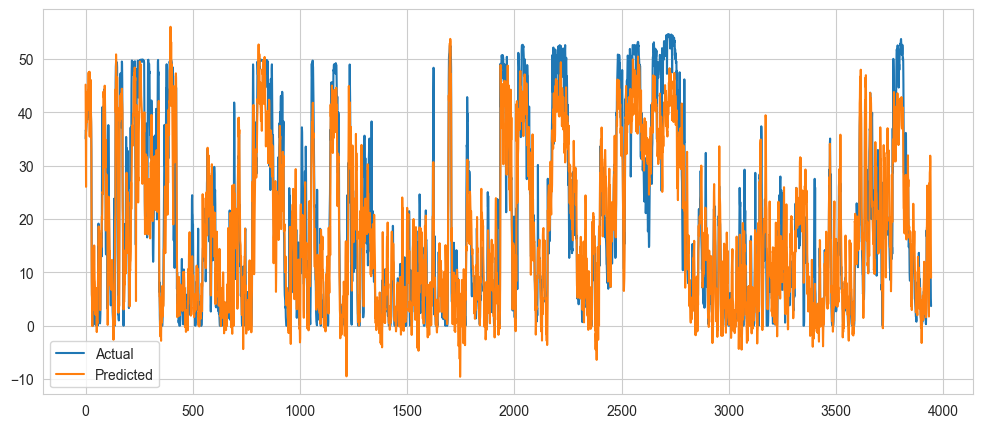

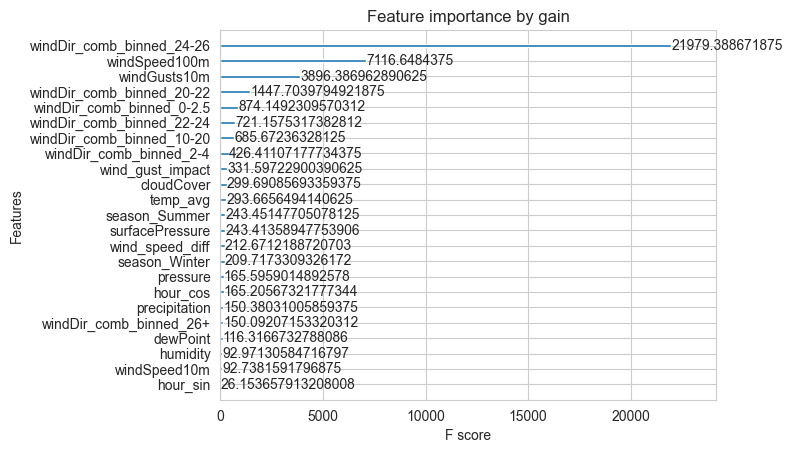

[I 2023-11-27 22:36:32,839] Trial 0 finished with value: 8.98936125940845 and parameters: {'learning_rate': 0.05309229620019251, 'colsample_bytree': 0.901762355052918, 'subsample': 0.8997463417638385, 'max_depth': 6, 'min_child_weight': 4}. Best is trial 0 with value: 8.98936125940845.
[I 2023-11-27 22:36:47,682] Trial 1 finished with value: 8.904131900244971 and parameters: {'learning_rate': 0.05702949348915487, 'colsample_bytree': 0.942933077793671, 'subsample': 0.9247875790484928, 'max_depth': 5, 'min_child_weight': 4}. Best is trial 1 with value: 8.904131900244971.
[I 2023-11-27 22:36:59,609] Trial 2 finished with value: 8.773275259695811 and parameters: {'learning_rate': 0.07538523621465976, 'colsample_bytree': 0.8174134865186409, 'subsample': 0.830687767082049, 'max_depth': 3, 'min_child_weight': 8}. Best is trial 2 with value: 8.773275259695811.
[I 2023-11-27 22:37:25,549] Trial 3 finished with value: 9.538720727269935 and parameters: {'learning_rate': 0.09628088485119068, 'cols

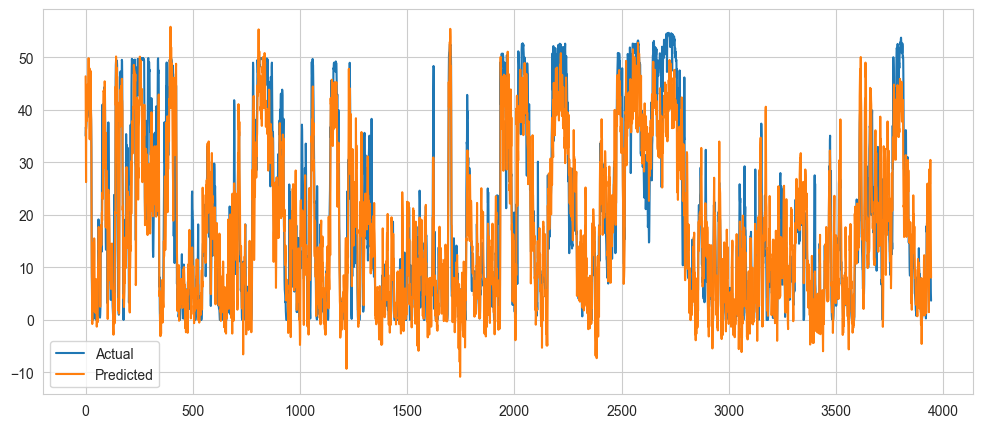

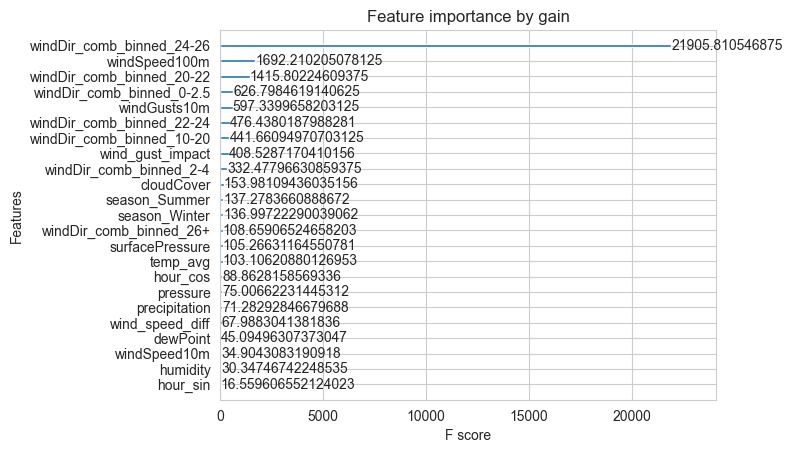

[I 2023-11-27 22:38:08,247] Trial 5 finished with value: 9.377923230612021 and parameters: {'learning_rate': 0.09737516654028786, 'colsample_bytree': 0.7768572008727688, 'subsample': 0.9169002842067459, 'max_depth': 8, 'min_child_weight': 7}. Best is trial 2 with value: 8.773275259695811.
[I 2023-11-27 22:38:23,970] Trial 6 finished with value: 8.97317726206418 and parameters: {'learning_rate': 0.07707161282778079, 'colsample_bytree': 0.9937948739426701, 'subsample': 0.9234555999559465, 'max_depth': 5, 'min_child_weight': 6}. Best is trial 2 with value: 8.773275259695811.
[I 2023-11-27 22:38:37,687] Trial 7 finished with value: 8.949000148104702 and parameters: {'learning_rate': 0.09803057217744568, 'colsample_bytree': 0.9977127461881307, 'subsample': 0.7925062897356874, 'max_depth': 4, 'min_child_weight': 4}. Best is trial 2 with value: 8.773275259695811.
[I 2023-11-27 22:38:52,578] Trial 8 finished with value: 8.689722287720198 and parameters: {'learning_rate': 0.03974954053845908, '

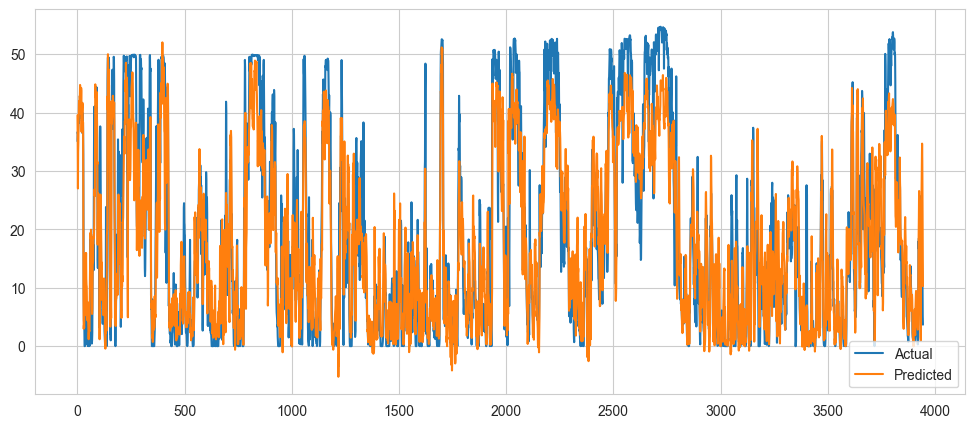

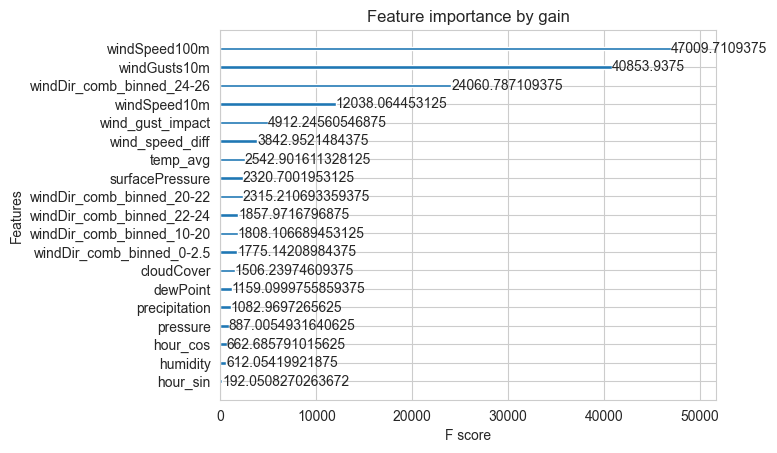

[I 2023-11-27 22:39:50,024] Trial 10 finished with value: 8.66707878721746 and parameters: {'learning_rate': 0.017763480268570025, 'colsample_bytree': 0.7060287438560581, 'subsample': 0.7006313991067903, 'max_depth': 3, 'min_child_weight': 3}. Best is trial 10 with value: 8.66707878721746.
[I 2023-11-27 22:40:13,623] Trial 11 finished with value: 8.676189349145435 and parameters: {'learning_rate': 0.014296209306075398, 'colsample_bytree': 0.7017949223890325, 'subsample': 0.7232893141791787, 'max_depth': 3, 'min_child_weight': 3}. Best is trial 10 with value: 8.66707878721746.
[I 2023-11-27 22:40:37,262] Trial 12 finished with value: 8.7009337387959 and parameters: {'learning_rate': 0.010513537960522288, 'colsample_bytree': 0.7090011887709041, 'subsample': 0.7120677868839135, 'max_depth': 3, 'min_child_weight': 5}. Best is trial 10 with value: 8.66707878721746.
[I 2023-11-27 22:41:02,357] Trial 13 finished with value: 8.71580223717648 and parameters: {'learning_rate': 0.0119310299420356

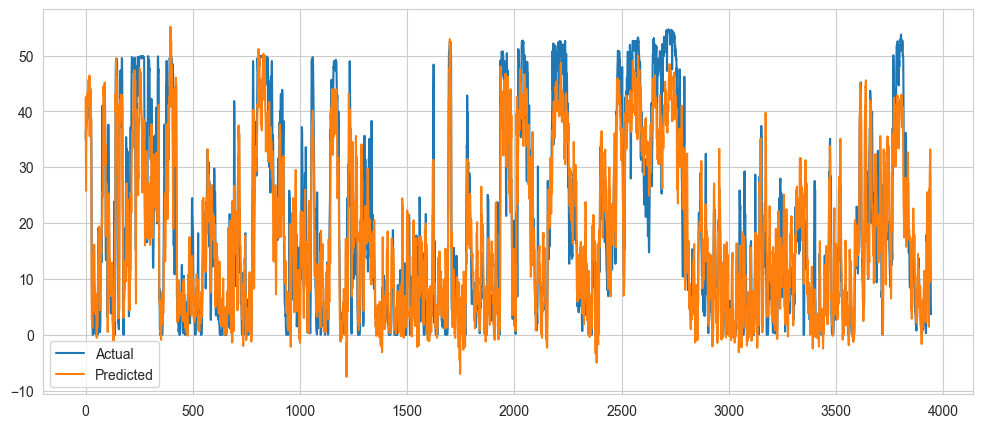

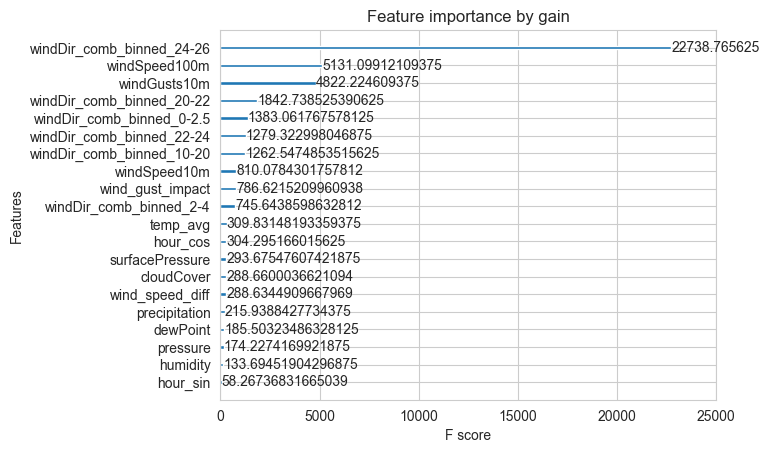

[I 2023-11-27 22:42:03,443] Trial 15 finished with value: 8.897476928843716 and parameters: {'learning_rate': 0.023822919932001394, 'colsample_bytree': 0.8039853878373356, 'subsample': 0.7441033231913722, 'max_depth': 7, 'min_child_weight': 3}. Best is trial 10 with value: 8.66707878721746.
[I 2023-11-27 22:42:34,308] Trial 16 finished with value: 8.760575292572014 and parameters: {'learning_rate': 0.022704634606276322, 'colsample_bytree': 0.7289992575901142, 'subsample': 0.704202430951012, 'max_depth': 5, 'min_child_weight': 4}. Best is trial 10 with value: 8.66707878721746.
[I 2023-11-27 22:43:21,391] Trial 17 finished with value: 8.956587540512 and parameters: {'learning_rate': 0.018512034095301527, 'colsample_bytree': 0.7005357976358855, 'subsample': 0.7489928545137816, 'max_depth': 10, 'min_child_weight': 5}. Best is trial 10 with value: 8.66707878721746.
[I 2023-11-27 22:43:43,757] Trial 18 finished with value: 8.671775467061131 and parameters: {'learning_rate': 0.029887659909028

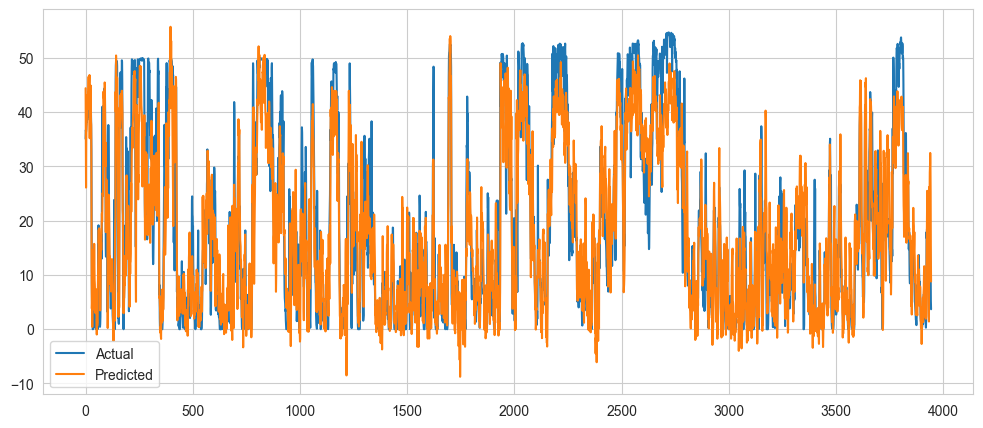

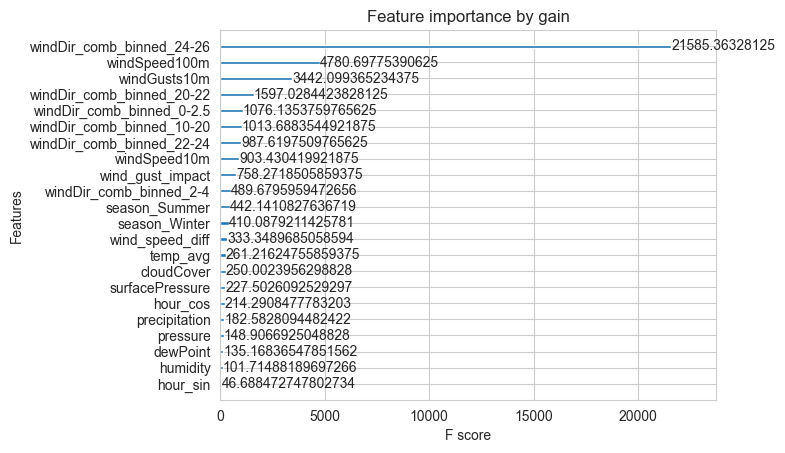

[I 2023-11-27 22:44:48,612] Trial 20 finished with value: 8.948618784065765 and parameters: {'learning_rate': 0.033164217898223824, 'colsample_bytree': 0.734953695124205, 'subsample': 0.762997214318512, 'max_depth': 7, 'min_child_weight': 7}. Best is trial 10 with value: 8.66707878721746.
[I 2023-11-27 22:45:11,178] Trial 21 finished with value: 8.674753277404596 and parameters: {'learning_rate': 0.016021112433125005, 'colsample_bytree': 0.728927379284347, 'subsample': 0.7257611812311086, 'max_depth': 3, 'min_child_weight': 6}. Best is trial 10 with value: 8.66707878721746.
[I 2023-11-27 22:45:32,562] Trial 22 finished with value: 8.666733365716102 and parameters: {'learning_rate': 0.019027657832239052, 'colsample_bytree': 0.7340781267904722, 'subsample': 0.7340100806744119, 'max_depth': 3, 'min_child_weight': 6}. Best is trial 22 with value: 8.666733365716102.
[I 2023-11-27 22:45:58,872] Trial 23 finished with value: 8.730694149324023 and parameters: {'learning_rate': 0.02809093118626

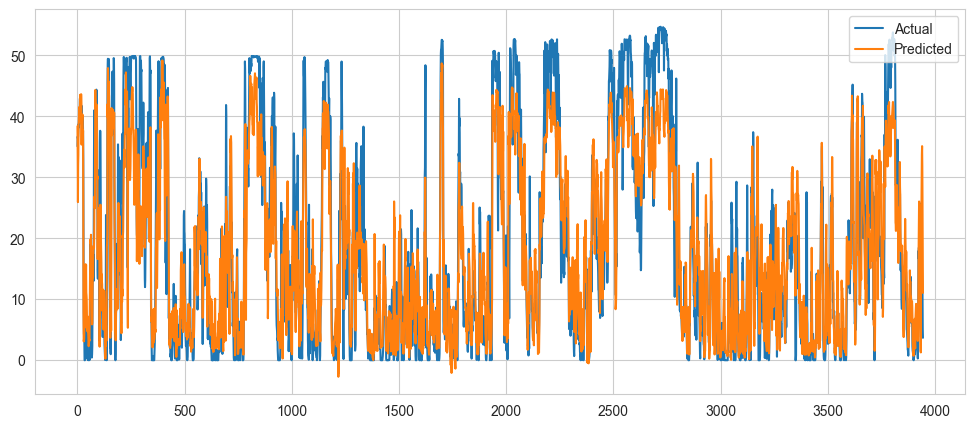

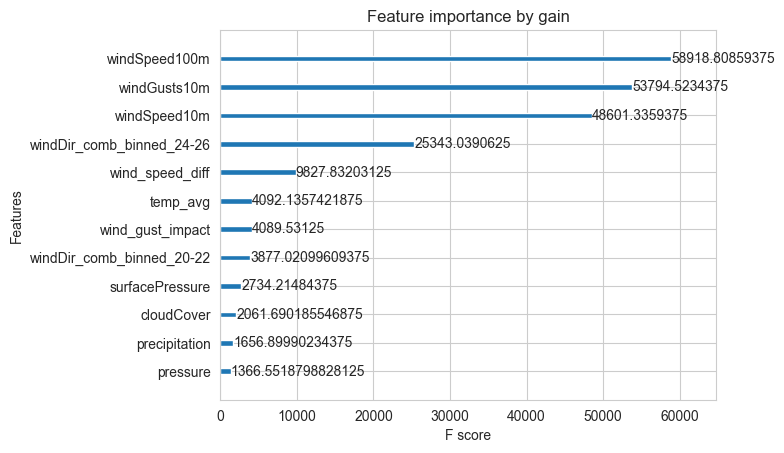

[I 2023-11-27 22:46:57,737] Trial 25 finished with value: 8.706392197583835 and parameters: {'learning_rate': 0.010386253430436965, 'colsample_bytree': 0.821909480117996, 'subsample': 0.7355656184230969, 'max_depth': 3, 'min_child_weight': 5}. Best is trial 22 with value: 8.666733365716102.
[I 2023-11-27 22:47:27,047] Trial 26 finished with value: 8.736348251659392 and parameters: {'learning_rate': 0.030296856340668164, 'colsample_bytree': 0.7438201882052423, 'subsample': 0.8196515930783396, 'max_depth': 4, 'min_child_weight': 6}. Best is trial 22 with value: 8.666733365716102.
[I 2023-11-27 22:47:51,481] Trial 27 finished with value: 8.668426344756174 and parameters: {'learning_rate': 0.018354322768767063, 'colsample_bytree': 0.7315593557721294, 'subsample': 0.7547435015882192, 'max_depth': 3, 'min_child_weight': 5}. Best is trial 22 with value: 8.666733365716102.
[I 2023-11-27 22:48:42,152] Trial 28 finished with value: 8.921300411429902 and parameters: {'learning_rate': 0.0175126533

In [40]:
xgb_study = optuna.create_study(direction='minimize')
xgb_study.optimize(objective, n_trials=30)

In [41]:
print('Best hyperparameters:', xgb_study.best_params)
save_model(xgb_study.best_params, "../models/xgboost_study_params_2.pkl")
save_model(xgb_study, "../models/xgboost_study2.pkl")

Best hyperparameters: {'learning_rate': 0.019027657832239052, 'colsample_bytree': 0.7340781267904722, 'subsample': 0.7340100806744119, 'max_depth': 3, 'min_child_weight': 6}


In [42]:
# Static parameters
static_params = {
    "objective": "reg:squarederror",
    "n_estimators": 1000,
    "verbosity": 0,
    'interaction_constraints': [["hour_sin","hour_cos"]]
}

# Merge static parameters with the best parameters from the study
params = {**static_params, **xgb_study.best_params}

model = xgb.XGBRegressor(**params)
model.fit(train_x,train_y)

pred_y = model.predict(test_x)

# Calculate RMSE
rmse = calculate_RMSE(test_y,pred_y)
print(f'RMSE: {rmse}')

# Calculate MAE
mae = calculate_MAE(test_y,pred_y)
print(f'MAE: {mae}')

RMSE: 9.0
MAE: 6.57


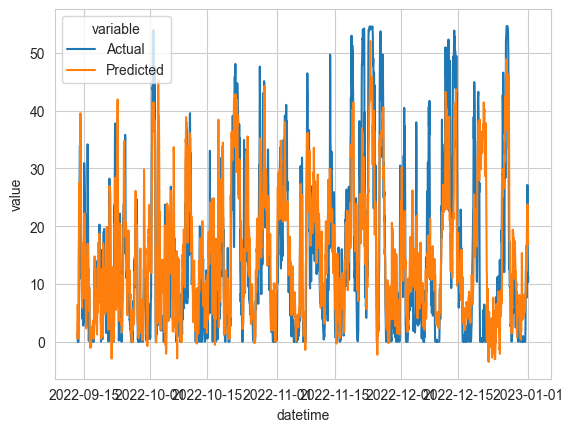

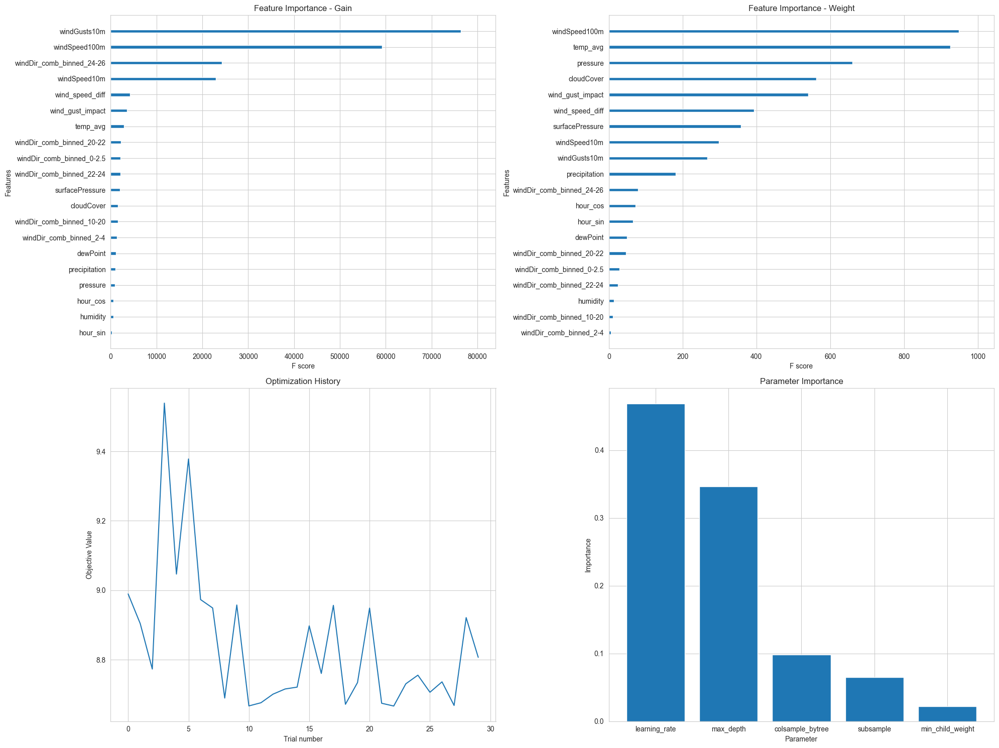

In [43]:
#Create a DataFrame for plotting
plot_df = pd.DataFrame({'Actual': test_y.values, 'Predicted': pred_y}, index=test_x.index)

# Reset index
plot_df_reset = plot_df.reset_index()

# Melt the DataFrame to have format suitable for seaborn
plot_df_melt = plot_df_reset.melt(id_vars=plot_df_reset.columns[0], value_vars=['Actual', 'Predicted'])

# Create the plot
sns.lineplot(data=plot_df_melt, x=plot_df_melt.columns[0], y='value', hue='variable')

plot_model_and_study(model, xgb_study)


## Observations and Insights

From the analysis of the feature importance graph, it is evident that wind-related components significantly influence the model's predictions. These features have the highest gain, indicating their substantial contribution to the model's decision-making process.

During the hyperparameter tuning trials, we closely monitored the loss function and the trial progress. This iterative process allowed us to identify the optimal parameters for our model.

Among the various parameters, the learning rate emerged as the most critical one. This is consistent with expectations, as the learning rate determines how much the model changes in response to the estimated error each time the model weights are updated. Choosing an appropriate learning rate is crucial for the model's performance.

Other parameters also played a significant role in the model's performance, and their optimal values were determined through the tuning process.

In [44]:
# Define the pipeline
pipeline = Pipeline([
    ('season_hour_extractor', SeasonHourExtractor(target_col='datetime')),
    ('wind_gust_impact', WindGustImpact()),
    ('wind_speed_differential', WindSpeedDifferential()),
    ('directional_efficiency', DirectionalEfficiency(column_names=['windDir100m', 'windDir10m'])),
    ('avg_temp', AvgTemp()),
    ('binned_direction_feature', BinnedDirectionFeature(bins=[0, 2.5, 4, 10, 20, 22, 24, 26, float('inf')], drop=True)),
    ('cyclic_feature_encoder', CyclicFeatureEncoder(col='hour', max_val=24, drop=True)),
    ('categorical_encoder', CategoricalEncoder(categorical_variables=['windDir_comb_binned', 'season'])),
    ('ensure_season_columns', EnsureSeasonColumns())

])

In [45]:
# train the model on the entire training set
model = xgb.XGBRegressor(**params)
train_y = baseline_train_df['prod']
train_x = pipeline.transform(baseline_train_df.drop(columns=['prod']))

model.fit(train_x, train_y)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.7340781267904722, device=None,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=None, grow_policy=None,
             importance_type=None,
             interaction_constraints=[['hour_sin', 'hour_cos']],
             learning_rate=0.019027657832239052, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=6, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=1000, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [46]:
# transform the test set using the pipeline
test_set = pipeline.transform(test_df)

In [47]:
# Get the feature names from the trained model
feature_names = model.get_booster().feature_names

# Reorder the columns in the test set to match the order in the training set
test_set = test_set[feature_names]

pred_y  = model.predict(test_set)

test_df['prod'] = pred_y

test_df.to_csv('../result/test_predictions.csv')


## Further Considerations and Suggestions

- **Increase Trial Number**: With a powerful GPU, the training time would be lower, allowing for a higher number of trials. This would make the hyperparameter tuning process more efficient.

- **Experiment with Column Combinations**: Different combinations of columns could be used in trials to evaluate the model's efficiency and performance improvements.

- **Ensemble Models**: The use of ensemble models, such as boosting, can greatly improve the accuracy of the predictions.

- **Post-Processing**: Post-processing could be applied for each hour or similar setting depending on the analysis of the predictions.

- **Algorithm Selection**: Different highly efficient algorithms like LightGBM could be compared with statistical models or tree-based models for ensemble usage.

- **Feature Engineering**: Depending on the region or city, more features could be added to the model.

- **Domain Knowledge**: Consultation with domain experts could provide valuable insights into the operation of the wind plant. For instance, there might be specific times when the plant underperforms or requires maintenance, which could affect the efficiency of the plant. Incorporating this information into the model could potentially improve its accuracy.